<a href="https://colab.research.google.com/github/nithecs-biomath/mini-schools/blob/main/colab_macfadyen_prac_3_short.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<a href="https://colab.research.google.com/github/nithecs-biomath/mini-schools/blob/main/macfadyen_prac_3_v3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<style>
/* tighten heading–paragraph gap */
h1, h2, h3, h4, h5, h6 { margin-bottom: 0.25rem; }

/* tighten gap above any paragraph that follows a heading */
h1 + p, h2 + p, h3 + p, h4 + p, h5 + p, h6 + p { margin-top: 0.25rem; }

/* justify body text */
p { text-align: justify; }
</style>

# Monitoring Biodiversity with Data Cubes: Techniques and Applications for Open Science

**Sandra MacFadyen** (macfadyen@sun.ac.za)

### Ecological Complexity and Biodiversity Mini-School
Hosted by the [National Institute for Theoretical and Computational Sciences](https://nithecs.ac.za/) (NITheCS) through the Complexity in Biological Systems (E5) research programme, this four-part Mini-school—under Work Package 1: Ecological Complexity and Biodiversity—equips participants with practical and conceptual skills to harness the power of environmental data cubes for biodiversity monitoring and ecological modelling.  

The course is designed for postgraduate students, early-career researchers, conservation professionals, and environmental data scientists interested in open, scalable, and reproducible workflows. It introduces participants to the use of multi-dimensional spatiotemporal data structures—known as "Data Cubes"—to monitor ecological patterns and processes across space and time. By combining open-access species-occurrence records from the [Global Biodiversity Information Facility](https://www.gbif.org/) (GBIF), environmental, and trait data with cloud-based tools like [Google Earth Engine](https://earthengine.google.com/) through [Google Colab](https://colab.google/), participants will learn how to build and apply biodiversity data cubes for analytical and decision-support purposes.
Rooted in the principles of Open Science, this Mini-school emphasises transparency, accessibility, and collaborative research. Each session aligns with one or more of the UN [Sustainable Development Goals](https://sdgs.un.org/goals) (SDGs), highlighting the societal relevance of biodiversity informatics.


### Work Package 1: Ecological Complexity and Biodiversity
This Mini-school is presented as part of Work Package 1 (WP1): Ecological Complexity and Biodiversity. WP1 explores how biodiversity patterns and ecological processes emerge, interact, and change across spatial, temporal, and biological scales. It aims to develop quantitative frameworks and open tools to better understand and monitor biodiversity in a changing world.
WP1 is structured around five core objectives:

1.  **Biodiversity Entropy and Symmetry Across Scales**: Develop a unified theoretical framework to harmonise biodiversity metrics across scales, reducing bias and exploring eco-evolutionary processes through the lens of entropy and symmetry.
2.	**Structural Emergence in Complex Adaptive Networks**: Investigate the stability, resilience, and emergent properties of adaptive ecological networks, from microbiomes to food webs, in response to both internal dynamics and external environmental shifts.
3.	**Biodiversity Dynamics in Protected Landscapes**: Quantify, model, and map biodiversity—from genes to ecosystems—across protected areas to understand ecological functioning and inform conservation policy and planning.
4.	**Spatiotemporal Dynamics and Adaptive Interactions in Ecosystems**: Model species distributions, biome transitions, and ecological disequilibria under climate change, using biodiversity metrics, movement data, and evolutionary game theory to explore adaptive interactions.
5.	**Innovative Computational Tools for Biodiversity Monitoring**: Develop open, scalable software tools—including a Biodiversity Informatics Hub and smart sensor systems—to support long-term biodiversity monitoring in African landscapes. This also includes building a research network across African protected areas to co-design training and capacity-building tailored to regional conservation needs.

This Mini-school contributes directly to objectives 3, 4, and 5.


### Biodiversity
Biodiversity—the variety of life on Earth—is the foundation of ecosystem health and resilience. It encompasses the diversity of genes, species, and ecosystems, and includes the complex interactions among organisms and their environments. This variety supports essential ecosystem functions such as nutrient cycling, pollination, and climate regulation, making biodiversity critical not only for nature but also for human well-being.
Biodiversity operates across multiple dimensions and scales:

-   **Composition**, **structure**, and **function** are key facets of biodiversity. Composition includes the identity and variety of species and genes present. Structure refers to the spatial organisation of biodiversity—species abundance, distribution patterns, and habitat arrangement. Function encompasses ecological processes and interactions such as energy flow and food web dynamics.
-   **Genetic diversity** refers to the variation of genes within species, enabling populations to adapt to changing conditions.
-   **Species diversity** reflects the number and variety of species in a given ecosystem or region.
-   **Ecosystem diversity** captures the range of different habitats—such as forests, wetlands, savannas, and coral reefs—that sustain life and ecosystem services.


Global threats like habitat loss, climate change, invasive species, and land degradation are causing rapid biodiversity declines. Monitoring biodiversity change across appropriate spatial and temporal scales has therefore become an urgent global priority. However, to respond effectively, we need globally relevant, standardised and scalable solutions that can track biodiversity patterns over time, inform conservation policy, and support ecosystem management.


### **Practical Session 3: Ecological Modelling with Data Cubes**
> In this hands-on session, participants will explore analytical approaches for modelling species distributions and environmental associations using biodiversity data cubes. Focusing on SDG 13 (Climate Action), the session will guide participants in investigating climate-related biodiversity responses and potential adaptation strategies.
By the end of the session, participants will be able to:
>
> 1.	Construct a biodiversity data cube using open-access species occurrence data from GBIF, processed via Google Colab and Earth Engine.
> 2.	Visualise ecological patterns interactively using spatial dashboards and maps.
> 3.	Analyse species diversity in relation to climatic and environmental variables, such as rainfall, temperature, and elevation, using summary statistics and visualisations.
>
> This session bridges computational ecology with applied conservation science, demonstrating how data-driven tools can inform real-world biodiversity management.


---
#### 1.	SETUP
> This section prepares the working environment for the data cube analysis. It ensures that all necessary packages are installed and available, initializes access to external services (e.g. Google Colab and Earth Engine), and connects to storage locations where datasets are kept or generated.


##### 1.2.	Install packages
Begin by installing the required Python libraries used throughout the workflow. These include geospatial, data science, and biodiversity informatics packages essential for data processing, analysis, and visualization.


In [ ]:
# -- Install only missing packages in Colab (or any Python env)
import importlib.util, subprocess, sys

# Colab (and most local installs) already include folium, shapely, numpy, pandas, etc.
_required_pkgs = [
    "geopandas",        # vector data processing
    "earthengine-api",  # Google Earth Engine Python client
    "geemap",           # interactive mapping for GEE
    "rasterio",         # raster I/O & processing
]

def _install(pkg):
    print(f"Installing {pkg}…")
    subprocess.check_call([sys.executable, "-m", "pip", "install", "--quiet", pkg])

for pkg in _required_pkgs:
    if importlib.util.find_spec(pkg) is None:
        _install(pkg)
    else:
        print(f"{pkg} already installed, skipping.")

In [ ]:
# -- Quick install/update other libraries
# !pip install --upgrade earthengine-api
# !pip install --upgrade pandas
# !pip install xgboost shap

##### 1.3.	Load packages
Once installed, the relevant packages are imported into the working session. This step makes their functions available for use in the script and ensures compatibility between modules.


In [55]:
# ──────────────────────────────────────────────────────────────────────────────
# IMPORTS: core utilities & OS interaction
import os                              # file & directory operations
from io import BytesIO                 # core I/O operations and in-memory streams
# import time                          # polite pauses between API calls (unused)
import zipfile                         # handle ZIP archives
import requests                        # HTTP requests for downloading
import importlib.metadata              # inspect package metadata/version

# ──────────────────────────────────────────────────────────────────────────────
# DATA STRUCTURES & GEOSPATIAL
import pandas as pd                    # tabular data handling
import geopandas as gpd                # GeoDataFrame and vector data operations
import numpy as np                     # numerical computing, arrays
import csv                             # CSV reading/writing
# import xarray as xr                 # labeled N-dimensional arrays (unused)
import folium                          # interactive web maps
from folium.raster_layers import ImageOverlay
# import branca                       # interactive web maps (unused)
import ee                              # Google Earth Engine Python API
import geemap                          # mapping extension for GEE Python API
import shapely                         # geometry objects and operations
from shapely.geometry import box       # create rectangular geometries
# from shapely.geometry import Polygon  # polygon geometries (unused)

# ──────────────────────────────────────────────────────────────────────────────
# REMOTE DATA DOWNLOAD
# import gdown                        # download from Google Drive (unused)

# ──────────────────────────────────────────────────────────────────────────────
# RASTER & TILE HANDLING
import rasterio                       # raster I/O and processing
from rasterio.transform import from_origin   # build affine transforms
from rasterio.features import rasterize      # rasterize vector data
# from rasterio.features import geometry_mask # vector-to-mask (unused)
from rasterio.plot import show        # quick plotting of rasters

# ──────────────────────────────────────────────────────────────────────────────
# MAPPING & VISUALIZATION
import matplotlib.pyplot as plt       # plotting library
import matplotlib.colors as mcolors   # color maps and normalization
from matplotlib.colors import BoundaryNorm, LogNorm
import matplotlib as mpl             # colormap reference
# from matplotlib_scalebar.scalebar import ScaleBar  # scale bars (unused)
from matplotlib.colors import (
    LinearSegmentedColormap,          # custom colormap construction
    Normalize,                        # normalize data to colormap
    BoundaryNorm,                     # discrete colormap intervals
    ListedColormap,                   # colormap from list of colors
    PowerNorm                         # Square root
)

# Optional basemap support:
# import contextily as cx             # add web‐basemap tiles under GeoPandas plots
# import localtileserver              # serve local raster tiles

# ──────────────────────────────────────────────────────────────────────────────
# MACHINE LEARNING & STATISTICS
import statsmodels.api as sm          # statistical models and inference
# from statsmodels.nonparametric.smoothers_lowess import lowess  # LOWESS smoothing (unused)

import xgboost as xgb                 # gradient‐boosted trees
# import shap                          # SHAP values for interpretability (unused)

from sklearn.model_selection import train_test_split  # data splitting
from sklearn.metrics import r2_score, mean_squared_error  # regression metrics
from sklearn.linear_model import LinearRegression    # simple linear model
from sklearn.inspection import permutation_importance  # model-agnostic importance

# ──────────────────────────────────────────────────────────────────────────────
# SPECIALIZED APIs
# from pygbif import occurrences        # GBIF biodiversity occurrence API (unused)

# ──────────────────────────────────────────────────────────────────────────────
# AFFINE GEOMETRY
from affine import Affine               # affine transformations (raster-to-world)

# ──────────────────────────────────────────────────────────────────────────────
# NOTE: This import block brings together data I/O, geospatial processing,
# statistical modeling, and machine‐learning libraries needed for full
# end-to-end analysis: from downloading raw data, through raster/vector
# manipulation, to predictive modeling and visualization.

In [ ]:
# Check package version
# print(importlib.metadata.version("earthengine-api"))   # ≥ 0.1.390 is fine

##### 1.4.	Initialise packages
Some packages require additional setup or authentication steps—such as logging in to Google services or initializing Earth Engine—to enable access to cloud-based resources and tools. Use the [Google Cloud Console](https://console.cloud.google.com/) for this.


In [3]:
# -- Initialise Google Earth Engine (requires one‑off authentication)
# Trigger the authentication flow
ee.Authenticate()

# -- Initialize the Project (see https://console.cloud.google.com/)
# ee.Initialize(project='ee-biomath')
ee.Initialize(project='ee-nithecs')

##### 1.5.	Mount drive when in [Google Colab](https://colab.research.google.com/) environment
This step links a cloud storage account (e.g. Google Drive) to the session. It allows read/write access to local folders in the cloud, which are used to store input data, intermediate outputs, and final results.


**CODE BLOCK BELOW ONLY WORKS IN COLAB ENVIRONMENT**

In [4]:
# Import ``google.colab' library
from google.colab import files

# Mount Google Drive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


---
#### 2.	LOAD OCCURRENCE DATA
> Species occurrence data form the foundation of biodiversity data cubes because they provide direct, spatially explicit records of where and when organisms have been observed. These data underpin our ability to quantify species distributions, assess patterns of species richness, and monitor changes in biodiversity over time. When structured appropriately, occurrence records can be aggregated into grid-based data cubes that support scalable, repeatable analyses across large regions and multiple time steps.
> This section introduces several ways to access or import species occurrence data from both local and remote sources. Local data may include curated datasets collected from field surveys, research networks, or institutional archives. Online sources—such as the Global Biodiversity Information Facility (GBIF) or data repositories hosted on GitHub—offer access to millions of open-access records contributed by museums, monitoring programmes, and citizen science initiatives. Whether working with structured CSV files, APIs, or live database queries, users will learn how to load, clean, and format occurrence data for integration into biodiversity data cubes.
> By combining these occurrence records with environmental and spatial metadata, we can begin to explore the composition, structure, and function of biodiversity across different ecological contexts—key elements discussed earlier in understanding biodiversity patterns and processes.


##### 2.1.	Read from local drive
Use pre-downloaded datasets stored in a local or mounted drive. This approach is useful for working offline or when using curated data from previous projects.


**CODE BLOCK BELOW ONLY WORKS IN COLAB ENVIRONMENT**

In [5]:
# Pick a local CSV/XLSX for upload
uploaded = files.upload()
# Expecting: table.csv
local_fn = next(iter(uploaded))
df_local = pd.read_csv(local_fn)
print(df_local.head())

Saving simulated_species_richness.csv to simulated_species_richness.csv
   Unnamed: 0  site_id       long        lat com_id species  abund
0           1     2601  31.524366 -24.553134   SK08    sp_1      0
1           2     2601  31.524366 -24.553134   SK08    sp_2     10
2           3     2601  31.524366 -24.553134   SK08    sp_3      6
3           4     2601  31.524366 -24.553134   SK08    sp_4      3
4           5     2601  31.524366 -24.553134   SK08    sp_5      9


In [6]:
# ──────────────────────────────────────────────────────────────────────────────
# Specify the path to your local data file; can be CSV or Excel
# local_fn = "data/sample_data_SA.csv"      # Local data e.g. "data/sample_data_SA.csv" or "table.xlsx"
# local_fn = 'https://raw.githubusercontent.com/nithecs-biomath/mini-schools/main/data/simulated_species_richness.csv' # Github data
local_fn = "/content/drive/MyDrive/nithecs_miniSchool/data/simulated_species_richness.csv" # Gdrive data

# ──────────────────────────────────────────────────────────────────────────────
# Determine file type by its extension and read accordingly
if local_fn.lower().endswith(".csv"):
    # For CSVs, we may have commas or tabs—let’s sniff the delimiter
    with open(local_fn, newline="") as f:
        # Read the first line and let the Sniffer detect comma vs. tab
        first_line = f.readline()
        dialect    = csv.Sniffer().sniff(first_line, delimiters=",\t")

    # Now read with pandas using the detected delimiter
    df_local = pd.read_csv(local_fn, sep=dialect.delimiter)

elif local_fn.lower().endswith((".xls", ".xlsx")):
    # For Excel files, use pandas' built-in reader
    df_local = pd.read_excel(local_fn)

else:
    # If it's neither CSV nor Excel, raise an informative error
    raise ValueError(f"Unsupported file type: {local_fn!r}")

# ──────────────────────────────────────────────────────────────────────────────
# Show the first few rows to confirm successful import
print(df_local.head())


   Unnamed: 0  site_id       long        lat com_id species  abund
0           1     2601  31.524366 -24.553134   SK08    sp_1      0
1           2     2601  31.524366 -24.553134   SK08    sp_2     10
2           3     2601  31.524366 -24.553134   SK08    sp_3      6
3           4     2601  31.524366 -24.553134   SK08    sp_4      3
4           5     2601  31.524366 -24.553134   SK08    sp_5      9


##### 2.2.	Import from Github
Access datasets that have been shared via a public [GitHub](https://github.com/) repository. This promotes reproducibility and ensures that everyone uses the same standard input files.


In [8]:
# ──────────────────────────────────────────────────────────────────────────────
# Define the URL of the raw CSV file hosted on GitHub
url = "https://raw.githubusercontent.com/nithecs-biomath/mini-schools/main/data/sample_data_SA.csv"

# ──────────────────────────────────────────────────────────────────────────────
# Option 1: Quick import assuming comma delimiter
# df_git = pd.read_csv(url)

# Option 2: Shorter alias for tab‐delimited data
# df_git = pd.read_table(url)

# Option 3: Explicitly specify tab delimiter for clarity and robustness
df_git = pd.read_csv(url, sep='\t') # Remove `, sep='\t` if coma separated

# ──────────────────────────────────────────────────────────────────────────────
# Print the total number of rows loaded (with thousands separator)
print(f"Rows: {len(df_git):,}")

# Display the first few rows to verify contents
df_git.head()

Rows: 136,402


,yearmonth,qdgccode,familykey,family,specieskey,species,occurrences,familycount
0,2024-08,E034N27BB,5142.0,Thalassianthidae,2257659.0,Heterodactyla hemprichii,1,7.0
1,2024-08,E034N27BB,7410.0,Cepheidae,2264568.0,Cephea cephea,1,3.0
2,2024-08,E034N27BB,8540.0,Lethrinidae,2374885.0,Lethrinus nebulosus,1,74.0
3,2024-08,E034N27BB,8542.0,Lutjanidae,2384758.0,Lutjanus bohar,1,71.0
4,2024-08,E034N27BB,8517.0,Chaetodontidae,2385470.0,Chaetodon semilarvatus,2,286.0


##### 2.3.	Access GBIF data
Query the [Global Biodiversity Information Facility](https://www.gbif.org/) (GBIF) directly from within the session. This allows users to search, filter, and download up-to-date species occurrence records for a target taxon and region. For example [DOI: 15468/dl.jh6maj](https://www.gbif.org/occurrence/download/0006880-241024112534372) containing all *Lepidoptera* species recorded in South Africa from 1998 until 2023.

###### Function `load_from_url_zip()`

In [9]:
# ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
# Function: load_from_url_zip
# --------------------------------------------------------------------
# Downloads a ZIP archive from a given URL, finds the first CSV inside,
# and reads it as a tab-delimited pandas DataFrame. Skips any bad lines
# and sets low_memory=False to suppress mixed‐type column warnings.
#
# Parameters:
#   zip_url : str
#     URL pointing to a .zip file containing at least one .csv
#
# Returns:
#   pd.DataFrame
#     The contents of the first .csv in the archive, parsed with sep='\t'
# ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
def load_from_url_zip(zip_url):
    """
    Downloads a ZIP from `zip_url`, finds the first .csv inside,
    reads it as a tab-delimited DataFrame (skipping bad lines),
    and returns the DataFrame with low_memory=False to avoid DtypeWarning.
    """
    # 1. Fetch the ZIP file from the web
    resp = requests.get(zip_url)
    # 2. Raise an error if the download did not succeed (e.g., 404)
    resp.raise_for_status()

    # 3. Open the downloaded bytes as a ZIP archive
    zf = zipfile.ZipFile(BytesIO(resp.content)) # type: ignore

    # 4. Iterate through each file in the archive
    for fname in zf.namelist():
        # 5. Look for the first .csv (case-insensitive)
        if fname.lower().endswith('.csv'):
            # 6. Open the CSV file within the ZIP
            with zf.open(fname) as f:
                # 7. Read into pandas, using tab delimiter and skip bad lines
                df = pd.read_csv(
                    f,
                    sep='\t',             # tab-separated values
                    on_bad_lines='skip',  # drop malformatted rows
                    low_memory=False      # avoid mixed‐dtype warnings
                )
            # 8. Return the loaded DataFrame and exit the loop
            return df

    # 9. If no CSV was found, raise an error
    raise FileNotFoundError("No CSV file found in archive")
# ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

###### Run `load_from_url_zip()`

In [10]:
# ──────────────────────────────────────────────────────────────────────────────
# 1. Download & load GBIF occurrence data from a ZIP URL
#    Using the pre-defined `load_from_url_zip()` function, which:
#      • Downloads the ZIP
#      • Extracts the first .csv inside
#      • Reads it as a tab-delimited pandas DataFrame
#      • Skips any bad lines and avoids dtype warnings
# ------------------------------------------------------------------------------

# Choose one of the GBIF download URLs:
url_zip = 'https://api.gbif.org/v1/occurrence/download/request/0006880-241024112534372.zip'
# (81,825 Lepidoptera occurrences)
# url_zip = 'https://api.gbif.org/v1/occurrence/download/request/0021941-250525065834625.zip'
# (2,337 Ceratotherium simum occurrences)

# Run the helper function to fetch and parse the ZIP
df_url = load_from_url_zip(url_zip)

# ──────────────────────────────────────────────────────────────────────────────
# 2. Subset to the columns we actually need for downstream analysis
#    Keep only temporal (year, month), taxonomic, and spatial fields
# ------------------------------------------------------------------------------
df_url = df_url[
    [
        'year',
        'month',
        'family',
        'speciesKey',
        'species',
        'decimalLatitude',
        'decimalLongitude'
    ]
]

# 3. Inspect the result
print(f"Rows loaded: {len(df_url):,}")
df_url.head(4)


Rows loaded: 81,825


,year,month,family,speciesKey,species,decimalLatitude,decimalLongitude
0,2012,10,Pieridae,1920506.0,Pieris brassicae,-34.420860,19.244099
1,2012,11,Pieridae,1920506.0,Pieris brassicae,-33.960445,18.755636
2,2012,10,Papilionidae,1938125.0,Papilio demodocus,-33.916512,18.403215
3,2012,10,Pieridae,5137998.0,Mylothris agathina,-34.420860,19.244099


---
#### 3.	SET AREA OF INTEREST AND GRID SIZE
> This section defines the geographic scope of the analysis and sets the resolution for spatial aggregation. It forms the spatial structure for data cube construction.



##### 3.1.	Read boundary shapefile
Import a shapefile that outlines the study area. This serves as the spatial boundary within which all analyses will be performed.


In [11]:
# SETUP & INPUTS
# ──────────────────────────────────────────────────────────────────────────────
# Assume these objects are already prepared:
# • grid_polys   : GeoDataFrame of quarter-degree grid cells
#                  (must include a numeric 'spp_rich' column for species richness)
# • boundary_gdf : GeoDataFrame of South African (and Lesotho/Eswatini) boundary
#                  in EPSG:4326
# • pts_gdf      : GeoDataFrame of occurrence points (optional; for scatter overlay)
# ---------------------------------------------------------------------

# If you need to upload boundary shapefiles (.shp, .shx, .dbf, .prj), you can use:
# files.upload()

# Optionally dissolve internal borders so only the outer outline is drawn:
# boundary_gdf = boundary_gdf.dissolve().reset_index(drop=True)

# ──────────────────────────────────────────────────────────────────────────────
# 1. Read the boundary GeoJSON/Shapefile directly from GitHub into EPSG:4326
# ---------------------------------------------------------------------
boundary_gdf = (
    gpd.read_file(
        "https://raw.githubusercontent.com/"
        "nithecs-biomath/mini-schools/main/"
        "data/south_africa_provinces_lesotho_eswatini.shp"
    )
    .to_crs("EPSG:4326")  # ensure lat/lon CRS for plotting
)

# ──────────────────────────────────────────────────────────────────────────────
# 2. (Optional) If you instead have local files, uncomment and use:
# ---------------------------------------------------------------------
# boundary_gdf = (
#     gpd.read_file("south_africa_provinces_lesotho_eswatini.shp")
#     .to_crs("EPSG:4326")
# )

# Now `boundary_gdf` is ready to plot under your `grid_polys` layer.


##### 3.2.	Generate grid
Divide the study area into regularly spaced square or rectangular grid cells. These cells act as analytical units for summarising biodiversity metrics.


Below is a single, self-contained function that *(a) builds a regular grid over your observation extent*, *(b) assigns each record to a cell*, and *(c) returns both the per-cell species–time counts and a GeoDataFrame of grid cells with richness/effort*:

###### Function `species_grid_summary()`

In [13]:
# ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
# Function: species_grid_summary
# --------------------------------------------------------------------
# Builds a regular grid over occurrence data, assigns records to cells,
# and returns both a tally of observations per cell and a grid GeoDataFrame
#
# Parameters:
#   df_raw   : pandas.DataFrame with occurrence records and coordinate columns
#   res       : float – grid resolution (in degrees if unit='deg', metres if 'm')
#   unit      : str   – "deg" or "m" (determines CRS and reprojection)
#   lat, lon  : str   – column names for latitude/longitude in df_raw
#   year, month, species : str – column names for temporal & taxon grouping
#   crs_deg   : str   – geographic CRS of input coords (default "EPSG:4326")
#
# Returns:
#   grid_counts : DataFrame with columns
#       [grid_id, year, month, species, count, centroid_lon, centroid_lat]
#   grid_gdf    : GeoDataFrame of grid cells with
#       [grid_id, spp_rich, obs_sum, geometry]
# ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
def species_grid_summary(
    df_raw,
    res=0.25, # Quarter degree (0.25) is ~27.8km and half a degree (0.5) is ~55.66Km at the equator
    unit="deg",
    lat="decimalLatitude",
    lon="decimalLongitude",
    year="year",
    month="month",
    species="species",
    crs_deg="EPSG:4326"
):
    # 0. Drop records missing coordinates
    df = df_raw[[year, month, species, lat, lon]].dropna(subset=[lat, lon]).copy()

    # 1. Create a GeoDataFrame of points in WGS84
    gdf_pts = gpd.GeoDataFrame(
        df,
        geometry=gpd.points_from_xy(df[lon], df[lat]),
        crs=crs_deg
    )

    # 2. If grid in metres, reproject points to a metric CRS
    if unit == "m":
        gdf_pts = gdf_pts.to_crs("EPSG:3857")

    # 3. Align the bounding box to the grid resolution
    xmin, ymin, xmax, ymax = gdf_pts.total_bounds
    xmin = np.floor(xmin / res) * res
    ymin = np.floor(ymin / res) * res
    xmax = np.ceil (xmax / res) * res
    ymax = np.ceil (ymax / res) * res

    # 4. Build square grid cells and track cell-centroids (in grid CRS)
    xs, ys = np.arange(xmin, xmax, res), np.arange(ymin, ymax, res)
    polys, ids, cx, cy = [], [], [], []
    for i, x0 in enumerate(xs):
        for j, y0 in enumerate(ys):
            polys.append(box(x0, y0, x0 + res, y0 + res))
            gid = f"g_{i}_{j}"
            ids.append(gid)
            cx.append(x0 + res/2)
            cy.append(y0 + res/2)

    grid_gdf = gpd.GeoDataFrame(
        {"grid_id": ids},
        geometry=polys,
        crs=gdf_pts.crs
    )

    # 5. Compute true centroids in WGS84 if metric grid, else use precalculated cx/cy
    if unit == "m":
        centroids = grid_gdf.geometry.centroid.to_crs("EPSG:4326")
        cent_lon, cent_lat = centroids.x, centroids.y
    else:
        cent_lon, cent_lat = cx, cy

    cent_df = pd.DataFrame({
        "grid_id":      ids,
        "centroid_lon": cent_lon,
        "centroid_lat": cent_lat
    })

    # 6. Spatially join points to grid cells
    joined = gpd.sjoin(
        gdf_pts,
        grid_gdf[["grid_id", "geometry"]],
        how="inner",
        predicate="within"
    )

    # 7. Count observations per grid-year-month-species
    grid_counts = (
        joined
        .groupby(["grid_id", year, month, species])
        .size()
        .reset_index(name="count")
        .merge(cent_df, on="grid_id", how="left")
    )

    # 8. Compute species richness & total effort per cell
    richness = grid_counts.groupby("grid_id")[species].nunique().rename("spp_rich")
    effort   = grid_counts.groupby("grid_id")["count"].sum().rename("obs_sum")
    stats    = pd.concat([richness, effort], axis=1).reset_index()

    # 9. Merge these stats back into the grid GeoDataFrame (fill missing with zero)
    grid_gdf = (
        grid_gdf
        .merge(stats, on="grid_id", how="left")
        .fillna({"spp_rich": 0, "obs_sum": 0})
    )

    return grid_counts, grid_gdf
# ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

###### Run `species_grid_summary()`

In [36]:
# ──────────────────────────────────────────────────────────────────────────────
# Example use of `species_grid_summary()` with a GBIF‐loaded DataFrame `df_url`
# ---------------------------------------------------------------------
# (If you had a local TSV, you might first load it like this:)
# df_raw = pd.read_csv("occurrence_table.tsv", sep="\t")

# ──────────────────────────────────────────────────────────────────────────────
# Call the function to build a 0.5° grid and summarise occurrences
# ------------------------------------------------------------------------------
grid_counts, grid_polys = species_grid_summary(
    df_url,                   # pandas.DataFrame with columns: year, month, species, decimalLatitude, decimalLongitude
    res=0.5,                 # grid resolution = 0.25 degrees (~27.8km at the equator)
    unit="deg",               # grid in geographic degrees; use "m" to build in projected metres
    lat="decimalLatitude",    # column name for latitude in df
    lon="decimalLongitude",   # column name for longitude in df
    year="year",              # column name for temporal grouping 1
    month="month",            # # column name for temporal grouping 2
    species="species",        # column name for taxon grouping
)

# ──────────────────────────────────────────────────────────────────────────────
# Inspect the per‐cell, per‐time, per‐species count table:
# ------------------------------------------------------------------------------
# columns: [grid_id, year, month, species, count, centroid_lon, centroid_lat]
# print(grid_counts.head())

# Inspect the GeoDataFrame of grid‐cells:
# columns: [grid_id, spp_rich, obs_sum, geometry]
# where:
#  • spp_rich = number of unique species in that cell
#  • obs_sum  = total observation count in that cell
print(f"Raw observation data had {len(df_url):,} records while new gridded data has {len(grid_polys):,} records")
# print(grid_polys.head())


Raw observation data had 81,825 records while new gridded data has 858 records



##### 3.3.	Visualise static map
Display the grid overlay on top of the study region using a map viewer. This step ensures the grid is correctly aligned and helps users explore the spatial configuration.

In [37]:
# ──────────────────────────────────────────────────────────────────────────────
# Aggregate total counts at each grid‐cell centroid
# --------------------------------------------------------------------
# We group by the centroid coordinates (lat, lon) to sum all 'count' values
# for each unique cell centroid, producing the total observations per cell.
cent_df = (
    grid_counts
      .groupby(
          ['centroid_lat', 'centroid_lon'],  # group by each cell’s centroid
          as_index=False                     # keep these as columns, not index
      )
      .agg(
          sum_cnt=('count', 'sum')           # sum of all counts in that cell
      )
)

# ──────────────────────────────────────────────────────────────────────────────
# Transform the summed counts to stabilize variance
# --------------------------------------------------------------------
# We take the square root of the total counts to reduce skew and heteroskedasticity.
cent_df["sqrt_sum_cnt"] = np.sqrt(cent_df["sum_cnt"])

# Display the first few rows: columns are centroid_lat, centroid_lon, sum_cnt, sqrt_sum_cnt
print(cent_df.head(4))


   centroid_lat  centroid_lon  sum_cnt  sqrt_sum_cnt
0        -34.75         19.25      359     18.947295
1        -34.75         19.75      195     13.964240
2        -34.75         20.25       89      9.433981
3        -34.25         18.25     4073     63.820060


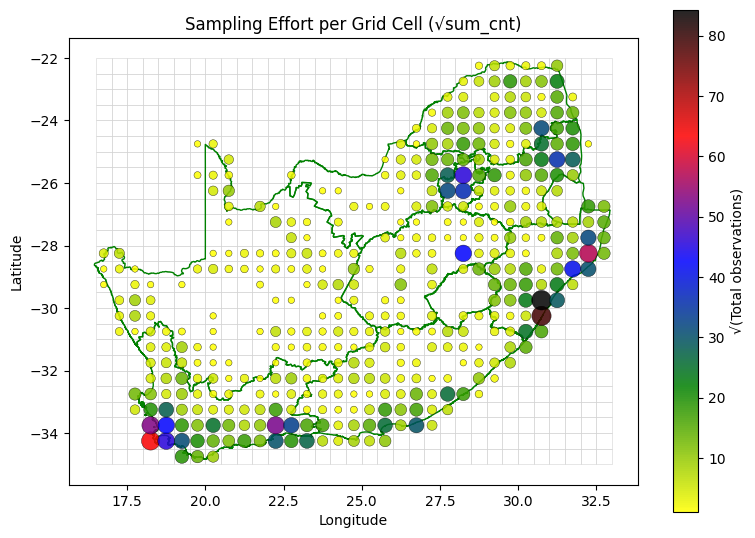

In [38]:
# ──────────────────────────────────────────────────────────────────────────────
# Custom colour ramp: yellow → green → blue → red → black
# --------------------------------------------------------------------
cmap = LinearSegmentedColormap.from_list(
    "YGBRB",                        # name of the colormap
    ["yellow", "green", "blue", "red", "black"],  # color sequence
    N=256                           # number of discrete steps
)
# Normalize colours to the range of √count values
norm = Normalize(
    vmin=cent_df["sqrt_sum_cnt"].min(),  # lower bound for colormap
    vmax=cent_df["sqrt_sum_cnt"].max()   # upper bound
)

# ──────────────────────────────────────────────────────────────────────────────
# Scale point sizes so that area ∝ √(obs_count)
# --------------------------------------------------------------------
sizes = np.sqrt(cent_df["sqrt_sum_cnt"])      # base sizes from √count
sizes = sizes * 200 / sizes.max()             # scale so max size ~200

# ──────────────────────────────────────────────────────────────────────────────
# Create figure & axes before plotting any layers
# --------------------------------------------------------------------
fig, ax = plt.subplots(figsize=(8, 7))

# 1. Plot grid cell outlines in light grey (zorder=1)
grid_polys.to_crs("EPSG:4326").boundary.plot(
    ax=ax,
    color="lightgrey",
    linewidth=0.4,
    zorder=1
)

# 2. Plot national boundary in green (zorder=2)
boundary_gdf.to_crs("EPSG:4326").boundary.plot(
    ax=ax,
    color="green",
    linewidth=1.0,
    zorder=2
)

# ──────────────────────────────────────────────────────────────────────────────
# Scatter centroids sized by sampling effort, coloured by √(sum_cnt)
# --------------------------------------------------------------------
sc = ax.scatter(
    cent_df["centroid_lon"],            # x-coordinate (longitude)
    cent_df["centroid_lat"],            # y-coordinate (latitude)
    s=sizes,                            # marker sizes
    c=cent_df["sqrt_sum_cnt"],          # marker colors
    cmap=cmap,                          # custom colormap
    norm=norm,                          # color normalization
    edgecolor="k",                      # black outline for each point
    linewidth=0.3,                      # outline thickness
    alpha=0.85,                         # marker transparency
    zorder=3                            # draw on top
)

# ──────────────────────────────────────────────────────────────────────────────
# Final touches: titles, labels, colorbar
# --------------------------------------------------------------------
ax.set_title("Sampling Effort per Grid Cell (√sum_cnt)")
ax.set_xlabel("Longitude")
ax.set_ylabel("Latitude")
ax.set_aspect("equal")                # equal scaling on x/y axes

# Add a colorbar showing the mapping of √count to color
cbar = fig.colorbar(
    sc,
    ax=ax,
    shrink=0.75,                      # scale colorbar length
    label="√(Total observations)"    # colorbar label
)

plt.tight_layout()
plt.show()

---
#### 4.	SUMMARISE OCCURRENCES BY GRID ID
> Once the spatial structure is set, species records are aggregated to grid cells. This section describes the derivation of key biodiversity indicators at the grid-cell level.



##### 4.1.	Calculate Sampling Effort (count total observations) and Species Richness (count unique species)
-  Calculate the number of records per grid cell. This metric approximates sampling effort and is useful for identifying areas with data biases or coverage gaps.
-  Count the number of unique species observed in each grid cell. Species richness is a basic but widely used indicator of biodiversity.


In [39]:
# ──────────────────────────────────────────────────────────────────────────────
# Prompt:
#   • Transpose the data.frame and sum species richness across years,
#     i.e. find how many unique species were recorded each year.
#   • Also compute the total number of observations per year.
#   • Then plot both as a time series (line chart).
# ──────────────────────────────────────────────────────────────────────────────

# 1. Compute species richness per year:
#    - group `grid_counts` by 'year'
#    - count unique 'species' values each year
species_richness_per_year = (
    grid_counts
      .groupby('year')['species']
      .nunique()
)
species_richness_per_year.name = 'spp_rich'

# 2. Compute total observations per year:
#    - group by 'year' and sum all 'count' values
total_observations_per_year = (
    grid_counts
      .groupby('year')['count']
      .sum()
)
total_observations_per_year.name = 'obs_cnt'

# 3. Combine into a single DataFrame for plotting
annual_summary = pd.concat(
    [species_richness_per_year, total_observations_per_year],
    axis=1
)
print(annual_summary.head(4))


      spp_rich  obs_cnt
year                   
1998         1        1
1999         1        1
2000        11       16
2001        29       29


##### 4.2.	Results - Line charts
Plot time series or summary statistics (e.g. number of observations or richness) using line charts to explore trends across time or spatial resolution.


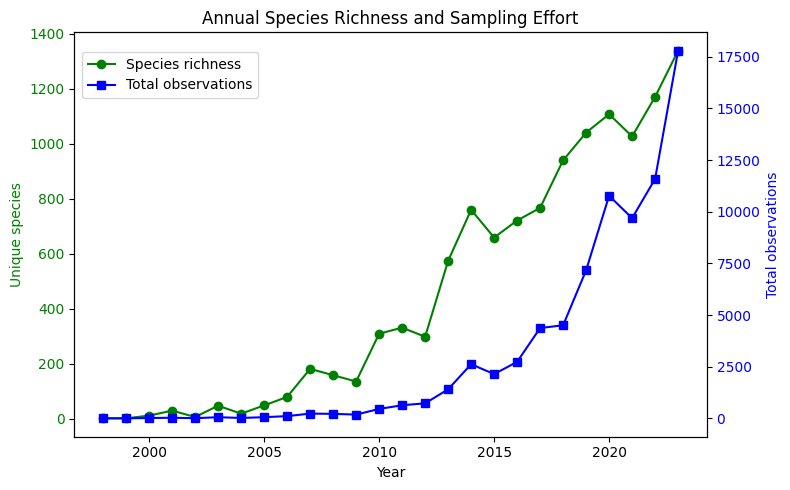

In [40]:
# ──────────────────────────────────────────────────────────────────────────────
# 1. Plot species richness and observation counts over time
fig, ax1 = plt.subplots(figsize=(8, 5))

years = annual_summary.index.astype(int)

# 1a. Plot species richness on primary y-axis
ax1.plot(
    years,
    annual_summary['spp_rich'],
    color='green',
    marker='o',
    label='Species richness'
)
ax1.set_xlabel('Year')
ax1.set_ylabel('Unique species', color='green')
ax1.tick_params(axis='y', labelcolor='green')

# 1b. Create a second y-axis sharing the same x-axis
ax2 = ax1.twinx()
ax2.plot(
    years,
    annual_summary['obs_cnt'],
    color='blue',
    marker='s',
    label='Total observations'
)
ax2.set_ylabel('Total observations', color='blue')
ax2.tick_params(axis='y', labelcolor='blue')

# 2. Decorations
plt.title('Annual Species Richness and Sampling Effort')
fig.legend(loc='upper left', bbox_to_anchor=(0.1, 0.9))
plt.tight_layout()
plt.show()

##### 4.3.	Results – Static Map
Visualise spatial patterns of sampling effort and species richness using map outputs. These maps can reveal biodiversity hotspots and under-sampled areas.

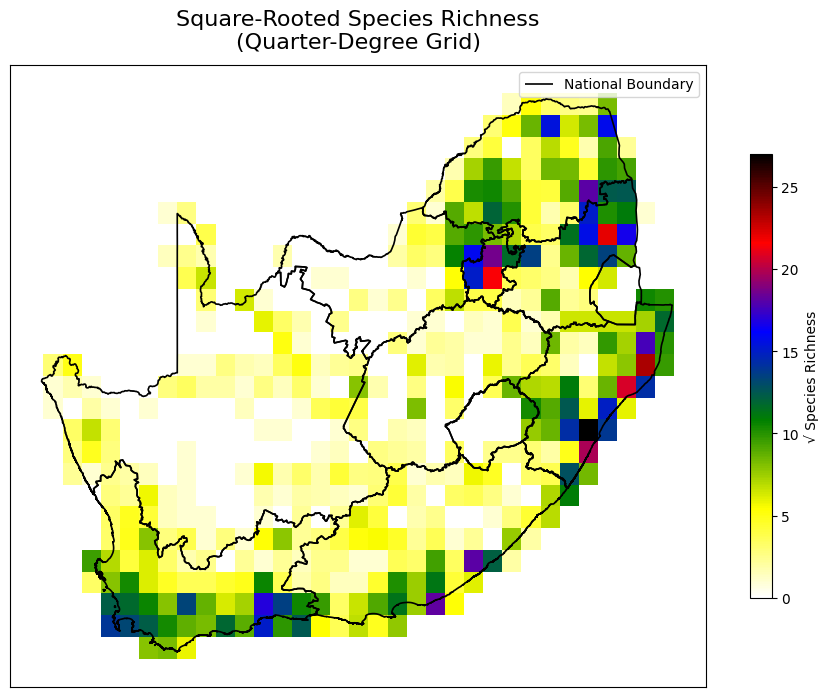

In [41]:
# ──────────────────────────────────────────────────────────────────────────────
# Ensure all spatial layers share the same geographic CRS (WGS84)
# ──────────────────────────────────────────────────────────────────────────────
crs_wgs84   = "EPSG:4326"
grid_polys  = grid_polys.to_crs(crs_wgs84)
boundary_gdf = boundary_gdf.to_crs(crs_wgs84)

# ──────────────────────────────────────────────────────────────────────────────
# Filter grid cells to those that touch the study boundary (no clipping)
# • Build a single (unioned) boundary geometry for fast intersection tests
# ──────────────────────────────────────────────────────────────────────────────
boundary_union = boundary_gdf.geometry.union_all()
grid_filtered  = grid_polys[grid_polys.geometry.intersects(boundary_union)].copy()

# ──────────────────────────────────────────────────────────────────────────────
# Square-root transform the species‐richness column
# • Stabilizes variance and reduces skew for visualization
# ──────────────────────────────────────────────────────────────────────────────
grid_filtered["spp_rich_sqrt"] = np.sqrt(grid_filtered["spp_rich"])

# ──────────────────────────────────────────────────────────────────────────────
# Define a custom colour ramp: white → yellow → green → blue → red → black
# • Use 256 discrete steps for smooth gradients
# ──────────────────────────────────────────────────────────────────────────────
my_colors = ["white", "yellow", "green", "blue", "red", "black"]
my_cmap   = LinearSegmentedColormap.from_list("wygbr", my_colors, N=256)

# ──────────────────────────────────────────────────────────────────────────────
# Plotting
# ──────────────────────────────────────────────────────────────────────────────
fig, ax = plt.subplots(figsize=(9, 7))

# 1. Plot the grid cells, coloured by √(species richness)
grid_filtered.plot(
    column="spp_rich_sqrt",            # which attribute to colour by
    ax=ax,
    cmap=my_cmap,                      # custom colormap
    linewidth=0,                       # no border lines between cells
    legend=True,                       # show colourbar
    legend_kwds={                      # colourbar settings
        "label": "√ Species Richness",
        "shrink": 0.7
    },
    vmin=0,                            # minimum colour scale
    vmax=grid_filtered["spp_rich_sqrt"].max()  # maximum colour scale
)

# 2. Overlay the national boundary outline
boundary_gdf.boundary.plot(
    ax=ax,
    color="black",
    linewidth=1.2,
    label="National Boundary"
)

# ──────────────────────────────────────────────────────────────────────────────
# Cosmetic tweaks
# ──────────────────────────────────────────────────────────────────────────────
ax.set_title(
    "Square-Rooted Species Richness\n(Quarter-Degree Grid)",
    fontsize=16,
    pad=12
)
ax.set_xticks([])  # remove x-axis tick marks
ax.set_yticks([])  # remove y-axis tick marks
ax.legend(loc="upper right")
plt.tight_layout()
plt.show()

##### 4.4.	Results - Interactive Folium Map
This routine begins by applying a square-root transformation to the species richness attribute on each grid polygon, then computes the spatial extent and aspect ratio of the study area to define the dimensions and affine transform of a new raster at a user-specified resolution. It pairs each polygon geometry with its transformed richness value and rasterizes these pairs into a 2D NumPy array. After ensuring the output directory exists, the script opens a new GeoTIFF with the correct CRS, dimensions, data type, and transform, writes the array as a single band, and closes the file.

In [42]:
# ---------------------------------------------------------------------
# Rasterize square-rooted species richness from a GeoDataFrame
# ---------------------------------------------------------------------

# 1. Extract the bounding box of your filtered grid cells
xmin, ymin, xmax, ymax = grid_filtered.total_bounds

# 2. Infer the grid resolution from the first cell’s bounds
minx, miny, maxx, maxy = grid_filtered.geometry.bounds.iloc[0]
res_x = maxx - minx    # pixel width
res_y = maxy - miny    # pixel height

# 3. Compute the number of columns and rows for the raster
n_cols = int((xmax - xmin) / res_x)
n_rows = int((ymax - ymin) / res_y)

# 4. Build the affine transform
#    Affine(scale_x, 0,      translate_x,
#           0,      -scale_y, translate_y)
transform = Affine(
    res_x,  0,    xmin,    # scale in x, no shear, x origin
    0,     -res_y, ymax    # no shear, negative scale in y, y origin
)

# 5. Prepare a generator of (geometry, value) pairs
#    feeding each cell polygon and its √species richness
shapes = (
    (geom, val)
    for geom, val in zip(
        grid_filtered.geometry,
        grid_filtered["spp_rich_sqrt"]
    )
)

# 6. Rasterize: burn values into a NumPy array
arr = rasterize(
    shapes,
    out_shape=(n_rows, n_cols),
    transform=transform,
    fill=0,            # background value for areas without cells
    dtype="float32"    # data type of output array
)

# 7. Ensure the output directory exists
output_dir = "/content/drive/MyDrive/nithecs_miniSchool/export/"
os.makedirs(output_dir, exist_ok=True)

# 8. Write the array to a single-band GeoTIFF
outfile = os.path.join(output_dir, "spp_rich_sqrt.tif")
with rasterio.open(
    outfile, "w",
    driver="GTiff",
    height=n_rows,
    width=n_cols,
    count=1,               # number of bands
    dtype=arr.dtype,
    crs="EPSG:4326",       # geographic CRS
    transform=transform
) as dst:
    dst.write(arr, 1)     # write array to band 1

print(f"✓ Wrote GeoTIFF: {outfile}")

✓ Wrote GeoTIFF: /content/drive/MyDrive/nithecs_miniSchool/export/spp_rich_sqrt.tif


This code block reads a GeoTIFF containing square‐root‐transformed species richness values, extracts the raster array and its geographic bounds, and builds a custom six‐step colormap normalised to the data range. The normalised values are mapped to an RGBA image array for display, and—if necessary—flipped to ensure north‐up orientation. A Folium map is then initialised at the raster’s centroid, the colored overlay is added with adjustable opacity, and a layer control widget is enabled to toggle the "√ Species Richness" layer on and off.

In [43]:
# ──────────────────────────────────────────────────────────────────────────────
# 1. Read your GeoTIFF of square‐rooted species richness
# --------------------------------------------------------------------
# # IF GDRIVE EXPORT FAILED, USE THE VERSION ON GITHUB TO CONTINUE >>
# https://raw.githubusercontent.com/nithecs-biomath/mini-schools/main/data/spp_rich_sqrt.tif
with rasterio.open("/content/drive/MyDrive/nithecs_miniSchool/export/spp_rich_sqrt.tif") as src:
    # Read only the first band (our single-layer raster)
    data = src.read(1)
    # Grab the geographic bounds (left, bottom, right, top)
    bounds = src.bounds

# ──────────────────────────────────────────────────────────────────────────────
# 2. Build a discrete Matplotlib colormap & normalization
# --------------------------------------------------------------------
# Define the color sequence from low to high values
my_colors = ["white", "yellow", "green", "blue", "red", "black"]
# Create a ListedColormap from that list
cmap = mcolors.ListedColormap(my_colors)
# Normalize data values to the [0,1] interval for the colormap
norm = mcolors.Normalize(vmin=data.min(), vmax=data.max())

# ──────────────────────────────────────────────────────────────────────────────
# 3. Map the data array to RGBA values
#    This produces an (height, width, 4) array with RGBA in [0,1]
# --------------------------------------------------------------------
rgba_img = cmap(norm(data))

# ──────────────────────────────────────────────────────────────────────────────
# 4. (Optional) Flip the image vertically if needed
#    If your raster’s first row is the top edge, you can skip this.
# --------------------------------------------------------------------
# rgba_img = np.flipud(rgba_img)

# ──────────────────────────────────────────────────────────────────────────────
# 5. Create a Folium map and overlay the RGBA image
# --------------------------------------------------------------------
# Center map on the raster’s midpoint
center_lat = (bounds.top + bounds.bottom) / 2
center_lon = (bounds.left + bounds.right) / 2

m = folium.Map(location=[center_lat, center_lon], zoom_start=6)

# Overlay the RGBA image with the proper geographic bounds
ImageOverlay( # type: ignore
    image=rgba_img,
    bounds=[[bounds.bottom, bounds.left],
            [bounds.top,    bounds.right]],
    opacity=0.7,
    name="√ Species Richness"
).add_to(m)

# ──────────────────────────────────────────────────────────────────────────────
# 6. Add the national boundary outline as a GeoJSON layer
# --------------------------------------------------------------------
folium.GeoJson(
    boundary_gdf,  # your boundary GeoDataFrame
    name="Boundary",
    style_function=lambda feature: {
        "fill": False,
        "color": "black",
        "weight": 2,
        "opacity": 1
    }
).add_to(m)

# ──────────────────────────────────────────────────────────────────────────────
# 7. Add layer control and display the map
# --------------------------------------------------------------------
folium.LayerControl().add_to(m)
m  # In a notebook or folium‐enabled VS Code this will render the interactive map


---
#### 5.	CREATE YOUR FIRST DATA CUBES
> In this section, participants will construct biodiversity data cubes—structured as three-dimensional arrays that integrate space, time, and ecological variables. Each cube captures how a specific biodiversity metric (e.g. sampling effort or species richness) varies across geographic locations (latitude × longitude) over multiple time steps (e.g. years or months). This structure allows for efficient storage, querying, and analysis of large spatiotemporal datasets.
> As illustrated in the image, the data cube is organised with spatial layers (rows and columns representing grid cells) stacked across a time axis (e.g. Year 1 to Year 5). Each “slice” of the cube represents a complete spatial layer for one time step, and the full cube enables users to trace changes through time at any given location or across the entire landscape.
Visualisation plays a key role in understanding and communicating these dynamics. Once the cube is built, maps and animated plots can be used to display how biodiversity indicators change over time and space. This can reveal trends such as increasing sampling effort in certain areas, emerging biodiversity hotspots, or declining richness in response to environmental pressures.



##### 5.1.	Spatio-Temporal Data Cube >> Sampling Effort
Here, participants will build a data cube that records the number of occurrence records (i.e. sampling effort) for each grid cell in each time period. Each layer in the cube corresponds to a different year or time step, and each cell holds the count of records observed in that space-time unit. This cube helps identify spatial sampling biases and temporal coverage gaps.
Visualization of this cube can include animated heatmaps or time-series plots that show changes in sampling intensity across the landscape and over time. These outputs are useful for diagnosing data quality and guiding future sampling campaigns.


In [44]:
# ──────────────────────────────────────────────────────────────────────────────
# 1. Aggregate total observations per grid cell per year
#    We group by grid_id, centroid coordinates, and year, then sum the 'count' values
# --------------------------------------------------------------------
obs_cnt = (
    grid_counts
      .groupby(['grid_id', 'centroid_lat', 'centroid_lon', 'year'])['count']
      .sum()
      .unstack(level='year')    # pivot years into separate columns
)

# 2. Replace any missing year–cell combinations with zero observations
# --------------------------------------------------------------------
obs_cnt = obs_cnt.fillna(0)

# 3. Inspect the table structure and summary statistics
# --------------------------------------------------------------------
# Print the first few rows to see the layout
print(obs_cnt.head(4))

# Get quick descriptive stats (count, mean, std, min, max, etc.) for each year
# print(obs_cnt.describe())

# (Optional) Compute specific summary stats across all years
# stats = obs_cnt.agg(['min','mean','max'])
# print(stats)

year                               1998  1999  2000  2001  2002  2003  2004  \
grid_id centroid_lat centroid_lon                                             
g_0_11  -29.25       16.75          0.0   0.0   0.0   0.0   0.0   0.0   0.0   
g_0_12  -28.75       16.75          0.0   0.0   0.0   0.0   0.0   0.0   0.0   
g_0_13  -28.25       16.75          0.0   0.0   0.0   0.0   0.0   0.0   0.0   
g_10_1  -34.25       21.75          0.0   0.0   0.0   0.0   0.0   0.0   0.0   

year                               2005  2006  2007  ...  2014  2015  2016  \
grid_id centroid_lat centroid_lon                    ...                     
g_0_11  -29.25       16.75          0.0   0.0   0.0  ...   0.0   0.0   0.0   
g_0_12  -28.75       16.75          0.0   0.0   0.0  ...   0.0   0.0   0.0   
g_0_13  -28.25       16.75          0.0   0.0   0.0  ...   4.0   0.0   0.0   
g_10_1  -34.25       21.75          0.0   0.0   0.0  ...   2.0   5.0   0.0   

year                               2017  2018  2019  202

In [45]:
# ──────────────────────────────────────────────────────────────────────────────
# 1. Join per‐year observation counts to the grid polygons
#    • `obs_cnt` has grid_id as index and one column per year
#    • Joining drops the temporary centroid columns used earlier
# ------------------------------------------------------------------------------
years = list(range(1998, 2024))  # years from 1998 through 2023 inclusive
gpObs = (
    grid_polys
      .set_index('grid_id')       # use grid_id to align with obs_cnt
      .join(obs_cnt)              # attach one column per year of counts
)

# ──────────────────────────────────────────────────────────────────────────────
# 2. Derive raster geometry parameters from the polygon grid
#    • Bounds of the full grid → origin
#    • Cell width/height from any single polygon’s bounds
#    • Compute number of columns & rows to cover the extent
# ------------------------------------------------------------------------------
minx, miny, maxx, maxy = gpObs.total_bounds

# Infer cell size from the first polygon
dx = gpObs.geometry.iloc[0].bounds[2] - gpObs.geometry.iloc[0].bounds[0] # type: ignore  # cell width
dy = gpObs.geometry.iloc[0].bounds[3] - gpObs.geometry.iloc[0].bounds[1] # type: ignore  # cell height

# Build an Affine transform for the raster (origin at top-left)
transform = from_origin(minx, maxy, dx, dy)

# Calculate raster dimensions
width  = int(np.round((maxx - minx) / dx))
height = int(np.round((maxy - miny) / dy))

# ──────────────────────────────────────────────────────────────────────────────
# 3. Rasterize observation counts for each year into a NumPy array
#    • Use a consistent NoData value that does not overlap real data
#    • Store each year’s 2D array in a dictionary for downstream use
# ------------------------------------------------------------------------------
nodata = -9999.0
arraysObs = {}

for yr in years:
    # Generator of (geometry, value) pairs
    shapes = ((geom, value) for geom, value in zip(gpObs.geometry, gpObs[yr]))
    # Rasterize into a float32 array
    arrObs = rasterize(
        shapes=shapes,
        out_shape=(height, width),
        transform=transform,
        fill=nodata, # type: ignore
        dtype='float32')
    arraysObs[yr] = arrObs

# Now `arraysObs[1998]`, `arraysObs[1999]`, …, `arraysObs[2023]`
# contain the rasterized observation counts per year.

vmin, vmax: 1.0 375.9800000000057


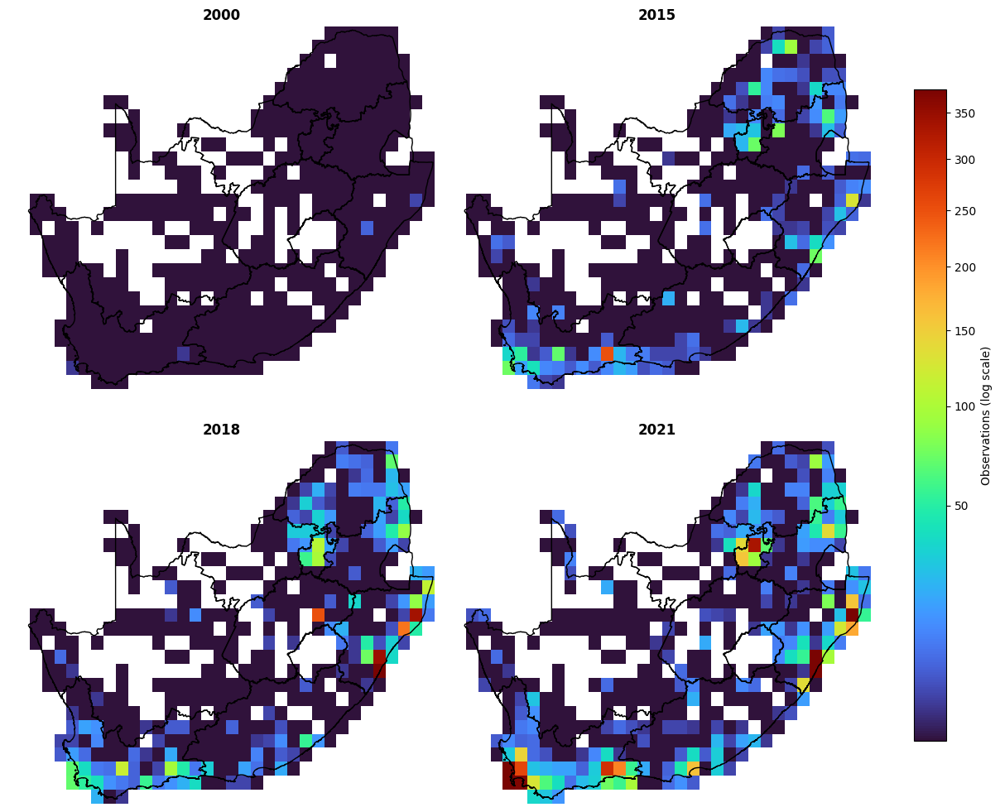

In [58]:
# ──────────────────────────────────────────────────────────────────────────────
# 1. Define which years to preview
# ------------------------------------------------------------------------------
# preview_years = [yr for yr in years if 2018 <= yr <= 2021] # e.g., 2018–2021
preview_years = [yr for yr in [2000, 2015, 2018, 2021] if yr in years]

# ──────────────────────────────────────────────────────────────────────────────
# 2. Collect all non‐zero, non‐nodata values across those years
#    This builds a 1D array for computing a common color scale
# ------------------------------------------------------------------------------
obs_nonzero = np.hstack([
    arraysObs[yr][
        (arraysObs[yr] != nodata) &
        (arraysObs[yr] > 0)
    ].ravel()
    for yr in preview_years
])

# ──────────────────────────────────────────────────────────────────────────────
# 3. Compute values for a discrete interval color scale
# ------------------------------------------------------------------------------
# 3a. choose vmin/vmax (e.g. the 1st and 99th percentiles to trim outliers)
vmin, vmax = np.percentile(obs_nonzero, [1, 99])
print("vmin, vmax:", vmin, vmax)

# 3b. optionally use LogNorm if the data are skewed or square-root
# norm = LogNorm(vmin=vmin, vmax=vmax) # Log stretch
norm = PowerNorm(gamma=0.5, vmin=vmin, vmax=vmax) # √ stretch

# ──────────────────────────────────────────────────────────────────────────────
# 4. Build a colormap and normalization based on those quantiles
# ------------------------------------------------------------------------------
# # Use the resampled API
# base = mpl.colormaps['viridis_r']
# cmap = base.resampled(len(obs_quant) - 1)
# norm = BoundaryNorm(obs_quant, ncolors=cmap.N, clip=True)

# Or pick a high-contrast colormap
# ------------------------------------------------------------------------------
cmap = plt.cm.turbo  # or 'plasma', 'magma', etc.

# ──────────────────────────────────────────────────────────────────────────────
# 5. Plot a 2×2 panel of raster previews with a consistent scale
# ------------------------------------------------------------------------------
fig, axes = plt.subplots(2, 2, figsize=(12, 10), constrained_layout=True)
for ax, yr in zip(axes.flat, preview_years):
    masked = np.ma.masked_equal(arraysObs[yr], nodata)
    im = show(
        masked,
        transform=transform,
        ax=ax,
        cmap=cmap,
        norm=norm,
        title=str(yr),
        # colorbar=False        # <-- REMOVE THIS LINE
    )
    boundary_gdf.boundary.plot(ax=ax, color='black', linewidth=1)
    ax.set_axis_off()

# Grab the image artist from one of the axes
mappable = axes.flat[0].get_images()[0]

# Add a single colorbar for all panels
cbar = fig.colorbar(
    mappable,
    ax=axes.ravel().tolist(),
    location='right',
    shrink=0.8
)
cbar.set_label('√ Observations')

plt.show()

In [59]:
# ──────────────────────────────────────────────────────────────────────────────
# Define output path and years
# ------------------------------------------------------------------------------
# obs_tif = 'data/sampling_effort_1998_2023.tif' # Local output
obs_tif = '/content/drive/MyDrive/nithecs_miniSchool/export/sampling_effort_1998_2023.tif' # GDrive output
years   = list(range(1998, 2024))  # inclusive list of years
nodata  = -9999.0                   # NoData flag used in arraysObs

# ──────────────────────────────────────────────────────────────────────────────
# Pre‐compute a mask for pixels inside the study boundary
# ------------------------------------------------------------------------------
# Create a single geometry covering all boundary features
boundary_union = boundary_gdf.geometry.union_all()

# Rasterize: 1 inside boundary, 0 outside → boolean mask
mask = rasterize(
    [(boundary_union, 1)],
    out_shape=(height, width),
    transform=transform,
    fill=0,
    dtype='uint8'
).astype(bool)

# ──────────────────────────────────────────────────────────────────────────────
# Write a multi‐band GeoTIFF where each band is one year’s effort raster
# and values outside the boundary or ≤0 are set to NoData
# ------------------------------------------------------------------------------
with rasterio.open(
    obs_tif,
    'w',
    driver='GTiff',
    width=width,
    height=height,
    count=len(years),       # one band per year
    crs=gpObs.crs,          # same CRS as the polygon grid
    transform=transform,
    dtype='float32',
    nodata=nodata,
    compress='lzw'          # lossless compression
) as dstObs:

    for i, yr in enumerate(years, start=1):
        # 1) Load the precomputed 2D numpy array for this year
        arr = arraysObs[yr]   # float32, with nodata flags already present

        # 2) Build a valid-data mask: must be inside boundary AND >0
        valid = mask & (arr > 0)

        # 3) Clip values outside boundary or non-positive to nodata
        clipped = np.where(valid, arr, nodata).astype('float32')

        # 4) Write the clipped array to band i, and set the band’s description
        dstObs.write(clipped, i)
        dstObs.set_band_description(i, str(yr))

print(f"✓ Wrote masked GeoTIFF '{obs_tif}' with {len(years)} annual bands.")

✓ Wrote masked GeoTIFF '/content/drive/MyDrive/nithecs_miniSchool/export/sampling_effort_1998_2023.tif' with 26 annual bands.


##### 5.2.	Spatio-Temporal Data Cube >> Species Richness
This cube stores species richness values (i.e. the number of unique species recorded) for each grid cell over multiple time steps. It enables users to explore biodiversity patterns across both spatial and temporal dimensions, facilitating the detection of shifts in species composition, local extinctions, or emerging biodiversity hotspots.
Visual outputs from this cube may include interactive maps, animated sequences, or 3D plots showing how richness evolves over time. These tools support interpretation of complex spatiotemporal patterns and are valuable for ecological forecasting, conservation prioritisation, and communicating results to stakeholders.

vmin, vmax: 1.0 375.9800000000057


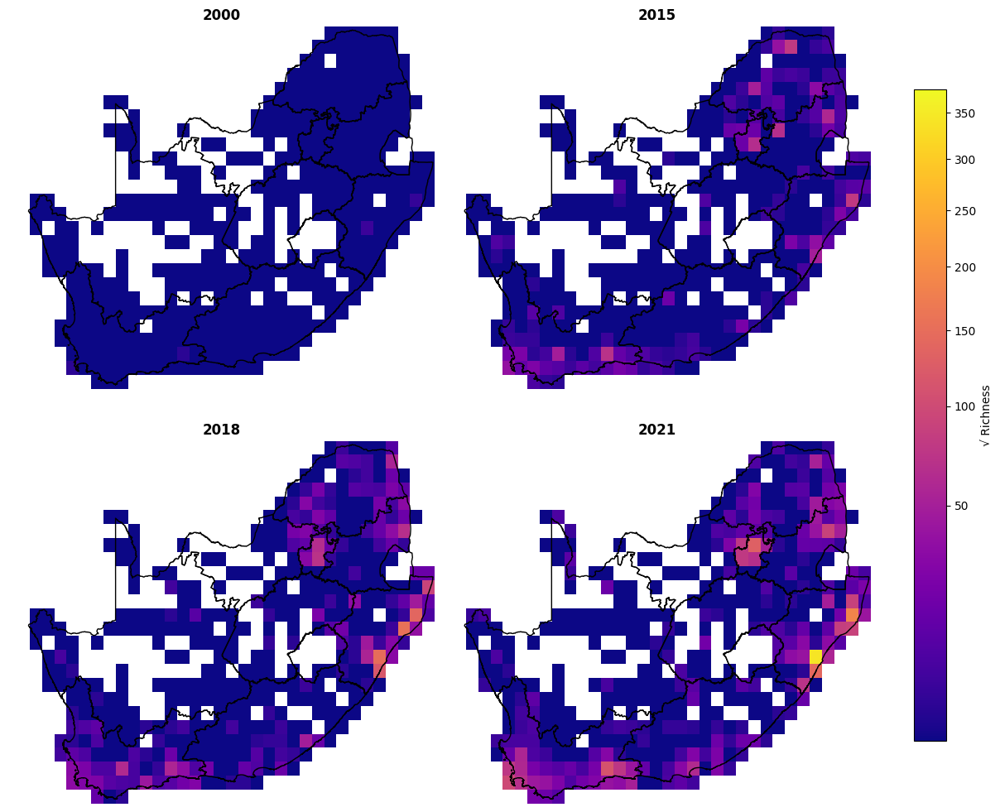

In [63]:
# ──────────────────────────────────────────────────────────────────────────────
# 1. Aggregate unique species per grid cell per year
#    • Group by grid_id and year, count distinct 'species', then pivot years to columns
# ------------------------------------------------------------------------------
spp_rich = (
    grid_counts
      .groupby(['grid_id', 'year'])['species']
      .nunique()
      .unstack(fill_value=0)  # one column per year, fill missing with 0
)

# ──────────────────────────────────────────────────────────────────────────────
# 2. Join richness table to grid polygons
#    • Drops centroid metadata since geometry already in grid_polys
# ------------------------------------------------------------------------------
years = list(range(1998, 2024))
gp = grid_polys.set_index('grid_id').join(spp_rich)

# ──────────────────────────────────────────────────────────────────────────────
# 3. Derive raster geometry parameters from the joined grid
#    • total_bounds → raster extent
#    • first polygon’s bounds → cell size (dx, dy)
#    • compute width, height, and affine transform
# ------------------------------------------------------------------------------
minx, miny, maxx, maxy = gp.total_bounds
dx = gp.geometry.iloc[0].bounds[2] - gp.geometry.iloc[0].bounds[0] # type: ignore   # cell width
dy = gp.geometry.iloc[0].bounds[3] - gp.geometry.iloc[0].bounds[1] # type: ignore  # cell height

transform = from_origin(minx, maxy, dx, dy)
width  = int(np.round((maxx - minx) / dx))
height = int(np.round((maxy - miny) / dy))

# ──────────────────────────────────────────────────────────────────────────────
# 4. Rasterize species richness for each year into a dict of arrays
#    • Use a consistent NoData flag
# ------------------------------------------------------------------------------
nodata = -9999.0     # pick any nodata flag that will never occur in your data
arraysRich = {}
for yr in years:
    shapes = ((geom, value) for geom, value in zip(gp.geometry, gp[yr]))
    arrich = rasterize(
        shapes=shapes,
        out_shape=(height, width),
        transform=transform,
        fill=nodata, # type: ignore
        dtype='float32')
    arraysRich[yr] = arrich

# ──────────────────────────────────────────────────────────────────────────────
# 5. Prepare a 2×2 preview of selected years with quantile‐based or normalised scale
# First define which years to preview
# ------------------------------------------------------------------------------
# preview_years = [yr for yr in years if 2018 <= yr <= 2021] # e.g., 2018–2021
preview_years = [yr for yr in [2000, 2015, 2018, 2021] if yr in years]

# ──────────────────────────────────────────────────────────────────────────────
# 5a. Stack all non‐zero, non‐nodata values to compute common quantiles
# ------------------------------------------------------------------------------
rich_nonzero = np.hstack([
    arraysRich[yr][(arraysRich[yr] != nodata) & (arraysRich[yr] > 0)].ravel()
    for yr in preview_years
])

# ──────────────────────────────────────────────────────────────────────────────
# 5a. Compute values for a discrete interval color scale
# ------------------------------------------------------------------------------
# Choose vmin/vmax (e.g. the 1st and 99th percentiles to trim outliers)
# rich_quant = np.quantile(rich_nonzero, np.linspace(0, 1, 6))
# print("Quantile breakpoints:", rich_quant)
vmin, vmax = np.percentile(obs_nonzero, [1, 99])
print("vmin, vmax:", vmin, vmax)

# Or use LogNorm if the data are skewed or square-root
# norm = LogNorm(vmin=vmin, vmax=vmax) # Log stretch
norm = PowerNorm(gamma=0.5, vmin=vmin, vmax=vmax) # √ stretch

# ──────────────────────────────────────────────────────────────────────────────
# 5b. Build discrete colormap + normalizer
# ------------------------------------------------------------------------------
# Use the resampled API
# base = mpl.colormaps['viridis_r']
# cmap = base.resampled(len(rich_quant) - 1)
# norm = BoundaryNorm(rich_quant, ncolors=cmap.N, clip=True)

# Or pick a high-contrast colormap
# ------------------------------------------------------------------------------
cmap = plt.cm.plasma  # or 'turbo', 'magma', etc.

# ──────────────────────────────────────────────────────────────────────────────
# 6. Plot a 2×2 panel of raster previews with a consistent scale
# ------------------------------------------------------------------------------
fig, axes = plt.subplots(2, 2, figsize=(12, 10), constrained_layout=True)
for ax, yr in zip(axes.flat, preview_years):
    masked = np.ma.masked_equal(arraysRich[yr], nodata)
    im = show(
        masked,
        transform=transform,
        ax=ax,
        cmap=cmap,
        norm=norm,
        title=str(yr),
        # colorbar=False        # <-- REMOVE THIS LINE
    )
    boundary_gdf.boundary.plot(ax=ax, color='black', linewidth=1)
    ax.set_axis_off()

# Grab the image artist from one of the axes
mappable = axes.flat[0].get_images()[0]

# Add a single colorbar for all panels
cbar = fig.colorbar(
    mappable,
    ax=axes.ravel().tolist(),
    location='right',
    shrink=0.8
)
cbar.set_label('√ Richness')

plt.show()

In [64]:
# ──────────────────────────────────────────────────────────────────────────────
# 0. Preliminaries: years list, nodata flag, CRS, transform, dimensions
# ------------------------------------------------------------------------------
years     = list(range(1998, 2024))  # inclusive list of annual bands
nodata    = -9999.0                  # flag for NoData values
crs_wgs84 = "EPSG:4326"              # target CRS for all layers

# 'transform', 'width', 'height', and 'gp' (grid polygons GeoDataFrame)
# are assumed defined as in prior steps.

# ──────────────────────────────────────────────────────────────────────────────
# 1. Build a geometry mask for the study boundary
#    • True inside the boundary, False outside
# ------------------------------------------------------------------------------
boundary_aligned = boundary_gdf.to_crs(crs_wgs84)

# Rasterize: 1 inside boundary, 0 outside → boolean mask
mask = rasterize(
    [(boundary_union, 1)],
    out_shape=(height, width),
    transform=transform,
    fill=0,
    dtype='uint8'
).astype(bool)

# ──────────────────────────────────────────────────────────────────────────────
# 2. Write a multi-band GeoTIFF of species richness per year
#    • Values ≤ 0 or outside boundary are set to NoData
# ------------------------------------------------------------------------------
rich_tif = '/content/drive/MyDrive/nithecs_miniSchool/export/species_richness_1998_2023.tif'

with rasterio.open(
    rich_tif,
    'w',
    driver     = 'GTiff',
    width      = width,
    height     = height,
    count      = len(years),    # one band per year
    crs        = crs_wgs84,
    transform  = transform,
    dtype      = 'float32',
    nodata     = nodata,
    compress   = 'lzw'
) as dst:

    for i, yr in enumerate(years, start=1):
        # 2a. Fetch the pre-rasterized array for this year
        arr = arraysRich[yr]

        # 2b. Build valid-data mask: inside boundary AND arr > 0
        valid = mask & (arr > 0)

        # 2c. Clip values: keep valid, else set to nodata
        clipped = np.where(valid, arr, nodata).astype('float32')

        # 2d. Write clipped array to band 'i' and label it with the year
        dst.write(clipped, i)
        dst.set_band_description(i, str(yr))

print(f"✓ Wrote masked GeoTIFF: {rich_tif} ({len(years)} annual bands, values ≤0 set to NoData)")

✓ Wrote masked GeoTIFF: /content/drive/MyDrive/nithecs_miniSchool/export/species_richness_1998_2023.tif (26 annual bands, values ≤0 set to NoData)


---
#### 6.	GET ENVIRONMENTAL COVARIATES
> Environmental covariates—such as temperature, precipitation, elevation, vegetation productivity, and human population density—are critical for understanding the patterns and processes underlying biodiversity. These variables influence species distributions, community composition, and ecological dynamics across spatial and temporal scales. Capturing them as Data Cubes enables the integration of environmental context into biodiversity analyses, providing consistent, multi-layered inputs for modelling and monitoring. Each variable takes a different structural form depending on their dimensions. Elevation is a simple 3D matrix with two spatial dimensions (latitude and longitude) and one variable (elevation), but no temporal component. In contrast, WorldClim’s bioclimatic variables form a multi-dimensional matrix or spatial data cube, consisting of spatial dimensions and multiple variables (e.g. BIO1 to BIO19), but still static in time. Meanwhile, variables like NDVI, rainfall, and surface water are true spatio-temporal data cubes—they include latitude, longitude, and time dimensions, with one variable per cube (e.g. NDVI index, precipitation in mm, or water presence/absence).
> Each cube encodes changes in an environmental variable across geographic space and time, allowing researchers to assess ecological responses to climate variability, habitat change, and anthropogenic pressures. These cubes are essential for linking biodiversity observations to their environmental drivers.   
> Browse available dataset on [Earth Engine Data Catalog](https://developers.google.com/earth-engine/datasets/) as well as the [awesome-gee-community-catalog](https://gee-community-catalog.org/projects/).   
>  



##### 6.0.	User inputs


In [65]:
# ──────────────────────────────────────────────────────────────────────────────
# 1. USER INPUTS: Define the analysis period
#    • start_date: first day to include (inclusive)
#    • end_date:   last day to include (inclusive)
# ------------------------------------------------------------------------------
start_date = ee.Date('2000-01-01')  # type: ignore
end_date   = ee.Date('2020-12-31')  # type: ignore

# ──────────────────────────────────────────────────────────────────────────────
# 2. Compute how many full months lie between start_date and end_date
#    • difference(..., 'month') returns a server-side Number
#    • .toInt() ensures we have an integer count
# ------------------------------------------------------------------------------
n_months = end_date.difference(start_date, 'month').toInt()  # type: ignore

# ──────────────────────────────────────────────────────────────────────────────
# 3. Build an Earth Engine List of month-offset indices
#    • sequence from 0 up to (n_months - 1)
#    • each element corresponds to months after start_date
# ------------------------------------------------------------------------------
month_ids = ee.List.sequence(0, n_months.subtract(1))  # type: ignore

# Now you can map over `month_ids` to create one image per month:
# month_images = ee.ImageCollection(month_ids.map(lambda m: make_periodic(m, 'month', 'sum', rain, south_africa, start_date)))

##### 6.1.	Country Boundaries
[LSIB 2017: Large Scale International Boundary Polygons, Simplified](https://developers.google.com/earth-engine/datasets/catalog/USDOS_LSIB_SIMPLE_2017) is a simplified version of the detailed LSIB (2013) derived from two other datasets: a LSIB line vector file and the World Vector Shorelines (WVS) from the National Geospatial-Intelligence Agency (NGA). Compared with the detailed LSIB, in this simplified dataset some disjointed regions of each country have been reduced to a single feature. Furthermore, it excludes medium and smaller islands. The resulting simplified boundary lines are rarely shifted by more than 100 meters from the detailed LSIB lines. Each of the 312 features is a part of the geometry of one of the 284 countries described in this dataset.

In [66]:
# ──────────────────────────────────────────────────────────────────────────────
# Define the Region of Interest (ROI) as South Africa (including Lesotho/Eswatini)
# ------------------------------------------------------------------------------
# Option A: Load from a public LSIB dataset and filter by country name
# south_africa = (
#     ee.FeatureCollection('USDOS/LSIB_SIMPLE/2017')
#       .filter(ee.Filter.inList('country_na', ['South Africa', 'Lesotho', 'Swaziland']))
# )

# Option B: Load from a custom Earth Engine asset (pre-uploaded boundary)
south_africa = ee.FeatureCollection( # type: ignore
    "projects/ee-nithecs/assets/rsa_boundary_shp"  # custom shapefile asset
)  # type: ignore

# Derive a rectangle covering the entire ROI (useful for exports or tiling)
aoi = south_africa.bounds()

##### 6.2.	Interactive mapping with `geemap`
This snippet initializes a Geemap interactive map centered on South Africa at zoom level 5, then populates the basemap gallery with three common layers—Roadmap (as the default), Hybrid, and Terrain—so users can switch seamlessly between vector, satellite, and topographic views. By leveraging `geemap`’s built-in Earth Engine integration, it provides a lightweight web map environment for overlaying remote-sensing imagery, vector boundaries, and other geospatial datasets, enabling real-time pan, zoom, and layer toggling without any manual HTML or JavaScript setup.


In [79]:
# ──────────────────────────────────────────────────────────────────────────────
# 1. Initialize an interactive map centered on South Africa
# ------------------------------------------------------------------------------
m = geemap.Map()

# after creation...
m.layout.height = '800px'
m.layout.width  = '90%'   # or '800px', etc.

m.centerObject(south_africa, zoom=5)  # smaller zoom ⇒ more zoomed out

# ──────────────────────────────────────────────────────────────────────────────
# 2. Add common basemap layers for user toggling
#    • "ROADMAP": default Google roadmap
#    • "HYBRID": satellite + labels
#    • "TERRAIN": terrain with relief shading
# ------------------------------------------------------------------------------
m.add_basemap("ROADMAP",    show=True)   # show by default
m.add_basemap("HYBRID",     show=False)
m.add_basemap("TERRAIN",    show=False)

# ──────────────────────────────────────────────────────────────────────────────
# 3. Overlay the South Africa boundary (no fill, semi-transparent outline)
# ------------------------------------------------------------------------------
m.addLayer(
    south_africa,           # EE FeatureCollection of RSA + Lesotho + Eswatini
    {
        "color": "black",    # boundary line color
        "fillOpacity": 0     # no interior fill
    },
    name="RSA + Lesotho + eSwatini",
    shown=True,
    opacity=0.5
)

# ──────────────────────────────────────────────────────────────────────────────
# 4. Finalize and display the map with layer controls
# ------------------------------------------------------------------------------
m.addLayerControl()  # enable the basemap and overlay toggles
m  # renders in Jupyter or VS Code notebook

Map(center=[-28.954638118727104, 25.366400313579497], controls=(WidgetControl(options=['position', 'transparen…

##### 6.3.	Elevation
[NASADEM: NASA 30m Digital Elevation Model](https://developers.google.com/earth-engine/datasets/catalog/NASA_NASADEM_HGT_001) is an enhanced 30-meter digital elevation model based on reprocessed Shuttle Radar Topography Mission (SRTM) data. Improvements include void-filling and error correction using auxiliary datasets such as ASTER GDEM, ICESat GLAS, and PRISM. The product represents elevation surfaces collected around 2000, offering accurate topographic information globally. Elevation data are essential for modeling terrain-driven processes such as hydrology, erosion, and species distributions. Derived products include slope, aspect, and hillshade, which are valuable inputs in environmental modeling, remote sensing, and biodiversity research in topographically complex landscapes.


In [68]:
# ──────────────────────────────────────────────────────────────────────────────
# Add NASADEM elevation layer to the interactive map `m`
# ------------------------------------------------------------------------------

# 1. Load NASADEM elevation band and clip to South Africa boundary
elev = (
    ee.Image('NASA/NASADEM_HGT/001')   # NASADEM global height # type: ignore
      .select('elevation')             # pick the elevation band
      .clip(south_africa)              # restrict to our ROI
)

# 2. Define visualization parameters:
#    • min/max elevation (m)
#    • color palette from deep green to white for high peaks
elev_vis = {
    'min': 0,
    'max': 2000,
    'palette': [
        '#004400',  # deep forest green
        '#228B22',  # medium green
        '#7FFF00',  # light green
        '#FFFF00',  # yellow
        '#F4A460',  # sandy tan
        '#8B4513',  # dark brown
        '#D9D9D9',  # light grey (rocky)
        '#FFFFFF'   # snow/ice
    ]
}

# 3. Add the elevation layer to the map
m.addLayer(
    elev,
    elev_vis,
    name="Elevation (m)"
)

# 4. (Optional) Re-add the boundary outline for context
#    Since we already added it earlier, set show=False to keep it available but hidden by default
m.addLayer(south_africa, {'color': 'black', 'fillOpacity': 0},
           "South Africa (Lesotho & eSwatini)",
           False)

# 5. Display the map (in a notebook or VS Code)
# m

In [33]:
# ──────────────────────────────────────────────────────────────────────────────
# Export the clipped NASADEM elevation image to a local GeoTIFF
# ------------------------------------------------------------------------------
# elev_tif = 'data/elevation_nasadem.tif'  # local file path for export
elev_tif = '/content/drive/MyDrive/nithecs_miniSchool/export/elevation_nasadem.tif'  # GDrive file path for export

geemap.ee_export_image(
    elev,                             # EE Image to export (no 'image=' keyword)
    filename     = elev_tif,          # local output path
    region       = south_africa.geometry(),  # clip/export region
    scale        = 5000,              # output resolution in meters (NASADEM ≈30m native)
    crs          = "EPSG:4326",       # coordinate reference system
    file_per_band=False              # combine all bands (just one here) into one file
)

print("✓ Elevation GeoTIFF saved →", elev_tif)

Generating URL ...
Please wait ...
Data downloaded to /content/drive/MyDrive/nithecs_miniSchool/export/elevation_nasadem.tif
✓ Elevation GeoTIFF saved → /content/drive/MyDrive/nithecs_miniSchool/export/elevation_nasadem.tif


##### 6.4.	Human Population
[LandScan Population Data Global 1km]( https://developers.google.com/earth-engine/datasets/catalog/projects_sat-io_open-datasets_ORNL_LANDSCAN_GLOBAL) provides a high-resolution global population dataset developed by Oak Ridge National Laboratory. It uses census data, satellite imagery, land use, and infrastructure to estimate population distribution at ~1 km resolution (30 arc-seconds). LandScan models ambient population, representing the average presence over 24 hours rather than residential counts. It is widely used in disaster risk reduction, epidemiology, and conservation planning, particularly in assessing human pressures on ecosystems. The spatial granularity supports integration with environmental and socio-economic models, making it useful for global sustainability and spatial decision-making studies.


In [69]:
# ──────────────────────────────────────────────────────────────────────────────
# Add LandScan global population (~1 km resolution) to the map
# ------------------------------------------------------------------------------

# 1. Load the LandScan Global Population ImageCollection
#    This contains annual population density rasters at ~1 km resolution.
landscan_global = ee.ImageCollection( # type: ignore
    'projects/sat-io/open-datasets/ORNL/LANDSCAN_GLOBAL'  # type: ignore
)

# 2. Define visualization parameters:
#    • min/max density (people per km²)
#    • a color palette from light greys to deep reds
pop_vis = {
    'min': 0,
    'max': 4200,
    'palette': [
        '#CCCCCC', '#FFFFBE', '#FEFF73', '#FEFF2C',
        '#FFAA27', '#FF6625', '#FF0023', '#CC001A', '#730009'
    ]
}

# 3. Compute the mean population density over all years, clip to RSA boundary
pop_mean = landscan_global.mean().clip(south_africa)

# 4. Add the population layer to the interactive map `m`
m.addLayer(
    pop_mean,
    pop_vis,
    name="Mean Population Density"
)

# 5. Display the updated map
# m

##### 6.5.	Roads
[Global Roads Inventory Project (GRIP) global roads database](https://gee-community-catalog.org/projects/grip/) was developed to provide a more recent and consistent global roads dataset for use in global environmental and biodiversity assessment models like GLOBIO. The GRIP dataset consists of global and regional vector datasets in ESRI filegeodatabase and shapefile format, and global raster datasets of road density at a 5 arcminutes resolution (~8km x 8km). The GRIP dataset is mainly aimed at providing a roads dataset that is easily usable for scientific global environmental and biodiversity modelling projects. The dataset is not suitable for navigation. GRIP4 is based on many different sources (including OpenStreetMap) and to the best of our ability we have verified their public availability, as a criteria in our research. The UNSDI-Transportation datamodel was applied for harmonization of the individual source datasets.


In [70]:
# ──────────────────────────────────────────────────────────────────────────────
# 1. Load & filter the Global Roads Inventory Project (GRIP4) for South Africa
# ------------------------------------------------------------------------------
grip4_africa = ee.FeatureCollection( # type: ignore
    "projects/sat-io/open-datasets/GRIP4/Africa"  # all African roads
)

# Clip to our ROI (South Africa + Lesotho + Eswatini boundary)
grip4_rsa = grip4_africa.filterBounds(south_africa.bounds())
# print(grip4_rsa.first().propertyNames().getInfo())
# print(grip4_rsa.first().getInfo()['properties'])

# ──────────────────────────────────────────────────────────────────────────────
# 2. Inspect available road-type codes (GP_RTP property)
# ------------------------------------------------------------------------------
unique_types = (
    grip4_rsa
      .aggregate_array('GP_RTP')  # collect all GP_RTP values
      .distinct()                 # remove duplicates
      .sort()                     # sort ascending
      .getInfo()                  # bring to client
)
print('Unique GP_RTP values:', unique_types)
# e.g. [1, 2, 3, 4, 5]

# ──────────────────────────────────────────────────────────────────────────────
# 3. Define styling for road types 1–3 only (others omitted/grouped)
#    • Type 1: Highways (red, thick)
#    • Type 2: Primary roads (blue, medium)
#    • Type 3: Secondary roads (green, thin)
# ------------------------------------------------------------------------------
styles = {
    1: {'color': '#e41a1c', 'width': 2.5}, # Highways
    2: {'color': '#377eb8', 'width': 2.0}, # Primary roads
    3: {'color': '#4daf4a', 'width': 1.0}, # Secondary roads
    # 4: {'color':"#d0d2cf", 'width':0.5},     # Tertiary roads
    # 5: {'color':"#e8eae7", 'width':0.5},     # Local roads
}

# ──────────────────────────────────────────────────────────────────────────────
# 4. Add each styled road layer to the interactive map
#    • Plot in reverse order so Type 1 is on top
#    • Off by default; users can toggle via layer control
# ------------------------------------------------------------------------------
for t in sorted(styles.keys(), reverse=True):  # 5,4,3,2,1
    fc = grip4_rsa.filter(ee.Filter.eq('GP_RTP', t)) # type: ignore
    m.addLayer(
        fc.style(color=styles[t]['color'], width=styles[t]['width']),
        {},
        f'Road Type {t}', False
    )

# ──────────────────────────────────────────────────────────────────────────────
# 5. Display the map with layer control (in Jupyter or VS Code)
# ------------------------------------------------------------------------------
# m.addLayerControl()
# m

Unique GP_RTP values: [1, 2, 3, 4, 5]


**Compute distance to nearest major road (meters)**   
This section extracts the primary transport network from the GRIP4 dataset (road categories 1–3), computes a continuous distance‐to‐nearest‐roads, and renders it interactively. First, we filter for highways, primary and secondary roads; next, we rasterize these features into a binary mask and calculate Euclidean distance (in meters, then converted to kilometers) within a 100 km radius; finally, we overlay this distance surface on the map to highlight zones of increasing remoteness from major roads.

In [71]:
# ──────────────────────────────────────────────────────────────────────────────
# 1. Filter GRIP4 roads to types 1–3 (highways, primary, secondary)
# ------------------------------------------------------------------------------
roads_1to3 = grip4_rsa.filter(ee.Filter.inList('GP_RTP', [1, 2, 3]))  # type: ignore

# ──────────────────────────────────────────────────────────────────────────────
# 2. Compute distance-to-nearest-road surface (meters)
#    • Paint all roads → binary mask
#    • distance() with a large kernel → Euclidean distance per pixel
#    • Clip to the study area
# ------------------------------------------------------------------------------
road_mask = ee.Image().byte().paint(roads_1to3, 1)  # 1 inside road, 0 elsewhere # type: ignore
dist_to_roads = (
    road_mask
      .distance(
          ee.Kernel.euclidean(radius=100000, units='meters'), # type: ignore
          False # type: ignore
      )
      .clip(south_africa.geometry()).divide(1000)
)

# 2a. Visualize distance surface (white = near, red = far up to 20 km)
m.addLayer(
    dist_to_roads,
    {'min': 0, 'max': 57, 'palette': ['ffffff','ff0000']},
    name='Distance to nearest main road'
)

# ──────────────────────────────────────────────────────────────────────────────
# 3. Display the interactive map (in Jupyter/VS Code)
# ------------------------------------------------------------------------------
# m.addLayerControl()
# m  # renders the map in notebook environments

**Compute distance to nearest road by type (meters)**   
In this section, we define a 5 km neighborhood radius and generate separate distance‐to‐roads for each road category (highway, primary, secondary). We encapsulate the workflow in a `make_dist_band()` function that:
1. Filters and rasterizes roads of a given type into a binary mask.
2. Computes Euclidean distance (m) to the nearest road pixel and clips to our study area.
3. Converts distances into kilometres and labels the band as `dist_type{t}`.
   
We then stack the three distance bands into a multi‐band image and add each layer to the interactive map using consistent styling (white at 0 km, red at 100 km) for direct comparison of remoteness across road types.

In [72]:
# ──────────────────────────────────────────────────────────────────────────────
# 1. Define the analysis parameters
#    • radius_m = 5 000 m, used for neighborhood operations if needed
# ------------------------------------------------------------------------------
radius_m = 5000  # neighborhood radius in metres

# ──────────────────────────────────────────────────────────────────────────────
# 2. Build a distance band for each road type (1–3)
#    • Paint each road type to a binary mask (1 on roads, 0 elsewhere)
#    • Compute the Euclidean distance (in metres) from every pixel to the nearest road
#    • Clip to the study area and convert to kilometres
#    • Rename each band as "dist_type{t}" for clarity
# ------------------------------------------------------------------------------
def make_dist_band(road_type):
    # a) Select and paint roads of this type into a binary image
    fc_roads = grip4_rsa.filter(ee.Filter.eq('GP_RTP', road_type))  # type: ignore
    mask      = ee.Image().byte().paint(fc_roads, 1) # type: ignore

    # b) Compute Euclidean distance (metres) to the nearest road pixel
    dist_m = (
        mask
          .distance(
              ee.Kernel.euclidean(radius=100000, units='meters'), # type: ignore
              False # type: ignore
          )
          .clip(south_africa.geometry())
    )

    # c) Convert metres → kilometres for easier interpretation
    dist_km = dist_m.divide(1000).rename(f"dist_type{road_type}")

    return dist_km

# 3. Create one distance image per road type and concatenate into a multi‐band image
dist_bands = [make_dist_band(t) for t in [1, 2, 3]]
dist_stack = ee.Image.cat(dist_bands)  # type: ignore
print("Bands in `dist_stack`:", dist_stack.bandNames().getInfo())

# ──────────────────────────────────────────────────────────────────────────────
# 4. Visualize each band on the interactive map `m`
#    • Use a common style: white = 0 km (on road), red = farthest (up to 100 km)
# ------------------------------------------------------------------------------
viz_params = {
    'min':     0,
    'max':   100,               # maximum distance in km for color scaling
    'palette': ['white', 'blue', 'red']
}

m.addLayer(dist_stack.select('dist_type1'), viz_params, 'Dist to Highways')
m.addLayer(dist_stack.select('dist_type2'), viz_params, 'Dist to Primary roads')
m.addLayer(dist_stack.select('dist_type3'), viz_params, 'Dist to Secondary roads')

# 5. Finally, render the map (in a notebook or geemap-enabled VS Code)
# m

Bands in `dist_stack`: ['dist_type1', 'dist_type2', 'dist_type3']


In [38]:
# ──────────────────────────────────────────────────────────────────────────────
# Export the multi-band distance‐to‐roads image to a local GeoTIFF
# ------------------------------------------------------------------------------
# dist_tif = 'data/dist_to_roads.tif'  # local filepath for the exported raster
dist_tif = '/content/drive/MyDrive/nithecs_miniSchool/export/dist_to_roads.tif'  # GDrive file path for export

geemap.ee_export_image(
    dist_stack,                     # EE Image containing stacked distance bands
    filename     = dist_tif,        # output filename
    region       = south_africa.geometry(),  # clip/export region
    scale        = 5000,            # output pixel size in metres
    crs          = "EPSG:4326",     # coordinate reference system
    file_per_band=False            # combine all bands into a single file
)

# Confirm export
n_bands = len(dist_stack.bandNames().getInfo())  # type: ignore
print(f"✓ Saved {n_bands}-band distance GeoTIFF → {dist_tif}")

Generating URL ...
Please wait ...
Data downloaded to /content/drive/MyDrive/nithecs_miniSchool/export/dist_to_roads.tif
✓ Saved 3-band distance GeoTIFF → /content/drive/MyDrive/nithecs_miniSchool/export/dist_to_roads.tif


##### 6.6.	Bioclimatic Variables
[WorldClim V1 Bioclim](https://developers.google.com/earth-engine/datasets/catalog/WORLDCLIM_V1_BIO) provides 19 biologically meaningful variables derived from monthly temperature and precipitation data, capturing seasonality, variability, and limiting climatic factors. These variables are frequently used in species distribution modeling, ecological niche modeling, and biodiversity assessments. Covering the period 1960–1991, this dataset offers a spatial resolution of approximately 927.67 meters. The dataset supports ecological and climate-related analyses across various scales and has become a standard reference for correlating climate with biological processes. The variables include annual means, seasonality indices, and extreme temperature/precipitation metrics relevant for understanding climatic constraints on species and ecosystems.


In [73]:
# ──────────────────────────────────────────────────────────────────────────────
# Add WorldClim BIO variables (v1) to the interactive map
# ------------------------------------------------------------------------------

# 1. Load the WorldClim Version 1 Bioclimatic variables and clip to RSA
bioclim = (
    ee.Image('WORLDCLIM/V1/BIO')     # 19 bioclimatic bands, unit-scaled # type: ignore
      .clip(south_africa)            # restrict to South Africa + neighbors
)

# 2. Define visualization parameters for Annual Mean Temperature (bio01)
#    • Multiply by 0.1 to convert to °C (per WorldClim scaling)
#    • Color palette from cold (blue) to hot (red)
bio_vis = {
    'min': -23,                      # lower bound in °C
    'max': 30,                       # upper bound in °C
    'palette': [
        'blue',    # cold
        'purple',
        'cyan',
        'green',
        'yellow',
        'red'      # warm
    ]
}

# 3. Add the bio01 layer (Annual Mean Temperature) to the map
m.addLayer(
    bioclim.select('bio01').multiply(0.1),  # convert scale to °C
    bio_vis,
    name="BIO01: Annual Mean Temperature (°C)"
)

# 4. Display the map with the new layer
# m

In [40]:
# ──────────────────────────────────────────────────────────────────────────────
# Export the multi-band BioClim image to a local GeoTIFF
# ------------------------------------------------------------------------------
# bioclim_tif = 'data/bioclim.tif'  # local filepath for the exported raster
bioclim_tif = '/content/drive/MyDrive/nithecs_miniSchool/export/bioclim.tif'  # GDrive file path for export

geemap.ee_export_image(
    bioclim,                     # EE Image containing stacked distance bands
    filename     = bioclim_tif,        # output filename
    region       = south_africa.geometry(),  # clip/export region
    scale        = 5000,            # output pixel size in metres
    crs          = "EPSG:4326",     # coordinate reference system
    file_per_band=False            # combine all bands into a single file
)

# Confirm export
print(f"✓ Saved {len(bioclim.bandNames().getInfo())}-band distance GeoTIFF → {bioclim_tif}")

Generating URL ...
Please wait ...
Data downloaded to /content/drive/MyDrive/nithecs_miniSchool/export/bioclim.tif
✓ Saved 19-band distance GeoTIFF → /content/drive/MyDrive/nithecs_miniSchool/export/bioclim.tif


##### 6.7.	Vegetation Greeness
[MOD13A3.061 Vegetation Indices Monthly L3 Global 1 km SIN Grid]( https://developers.google.com/earth-engine/datasets/catalog/MODIS_061_MOD13A3) provides monthly global vegetation indices at 1 km resolution. This product includes NDVI and EVI, derived from daily MODIS observations (MOD13A2) using a weighted temporal average. These indices reflect vegetation condition, biomass, and photosynthetic activity. NDVI is sensitive to chlorophyll content, while EVI minimizes atmospheric and canopy background effects. MOD13A3 is widely used in land cover monitoring, phenology, productivity modeling, and change detection. Applications range from local to global scales in climate-ecological studies, agricultural monitoring, and habitat suitability analyses. The dataset enables consistent long-term vegetation assessment across varied biomes.


In [80]:
# ──────────────────────────────────────────────────────────────────────────────
# 1. Load MODIS MOD13A3 Version 061 monthly NDVI (1 km) for the analysis period
# ------------------------------------------------------------------------------
ndvi = (
    ee.ImageCollection('MODIS/061/MOD13A3') # type: ignore
      .filter(ee.Filter.date(start_date, end_date))  # restrict by date range # type: ignore
      .select('NDVI')                                 # keep only the NDVI band
)

# ──────────────────────────────────────────────────────────────────────────────
# 2. Define visualization parameters for NDVI
#    • min/max values are scaled as in the MODIS product (0–9000)
#    • a sequential green‐to‐brown palette for vegetation vigor
# ------------------------------------------------------------------------------
ndvi_vis = {
    'min': 0,
    'max': 9000,
    'palette': [
        'ffffff', 'ce7e45', 'df923d', 'f1b555', 'fcd163',
        '99b718', '74a901', '66a000', '529400', '3e8601',
        '207401', '056201', '004c00', '023b01', '012e01',
        '011d01', '011301'
    ]
}

# ──────────────────────────────────────────────────────────────────────────────
# 3. Compute the mean NDVI across the time series and clip to the study area
# ------------------------------------------------------------------------------
# ndvi_mean = ndvi.mean().clip(south_africa)
ndvi_2008 = ee.Image(ndvi.toList(9).get(8)).clip(south_africa)

# ──────────────────────────────────────────────────────────────────────────────
# 4. Add the mean NDVI layer to the interactive map
# ------------------------------------------------------------------------------
m.addLayer(
    ndvi_2008,
    ndvi_vis,
    name="Mean NDVI (MOD13A3)"
)

# ──────────────────────────────────────────────────────────────────────────────
# 5. Display the map (in notebook or geemap‐enabled VS Code)
# ------------------------------------------------------------------------------
# m

##### 6.8.	Rainfall
[CHIRPS Pentad: Climate Hazards Center InfraRed Precipitation With Station Data v2.0](https://developers.google.com/earth-engine/datasets/catalog/UCSB-CHG_CHIRPS_PENTAD) offers a 30+ year quasi-global rainfall dataset combining satellite-derived precipitation estimates with station data. Available at 0.05° (~5 km) resolution, CHIRPS provides temporally consistent data suitable for monitoring rainfall patterns and detecting anomalies. It is especially useful in regions with sparse gauge coverage, offering reliable inputs for drought monitoring, agricultural planning, hydrological modeling, and climate trend analysis. The pentad format aggregates rainfall over 5-day intervals, balancing temporal resolution with data stability. CHIRPS has been widely adopted in food security and climate vulnerability applications, particularly across the tropics and subtropics.


In [81]:
# ──────────────────────────────────────────────────────────────────────────────
# 1. Load CHIRPS Pentad rainfall (UCSB‐CHG) for the analysis period
#    • Pentad = 5‐day composites
#    • Filter by start_date and end_date defined earlier
#    • Select only the 'precipitation' band
# ------------------------------------------------------------------------------
rain = (
    ee.ImageCollection('UCSB-CHG/CHIRPS/PENTAD') # type: ignore
      .filter(ee.Filter.date(start_date, end_date)) # type: ignore
      .select('precipitation')
)

# ──────────────────────────────────────────────────────────────────────────────
# 2. Define visualization parameters for mean rainfall (mm per pentad)
#    • min/max chosen to cover most realistic pentad totals
#    • palette from dry (white) to extreme rain (black)
# ------------------------------------------------------------------------------
rain_vis = {
    'min': 0,
    'max': 22,
    'palette': ['white', 'lightblue', 'blue', 'darkblue', 'black']
}

# ──────────────────────────────────────────────────────────────────────────────
# 3. Compute mean rainfall over the time series and clip to ROI
# ------------------------------------------------------------------------------
rain_mean = rain.mean().clip(south_africa)

# ──────────────────────────────────────────────────────────────────────────────
# 4. Add the mean rainfall layer to the interactive map
# ------------------------------------------------------------------------------
m.addLayer(
    rain_mean,
    rain_vis,
    name="Long-term Mean Rainfall"
)

# ──────────────────────────────────────────────────────────────────────────────
# 5. Render the map (in a notebook or VS Code)
# ------------------------------------------------------------------------------
# m

##### 6.9.	Calculate monthly or annual  summaries from `imageCollection`

Below is a flexible function that can produce either **monthly** or **annual** summaries (*sum or mean*) of `imageCollections` e.g. rain collection, clipped to `boundary_fc`:

###### Function `make_periodic()`

In [82]:
# ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
# Function: make_periodic
# --------------------------------------------------------------------
# Generate a periodic (monthly or yearly) aggregate image from an ImageCollection.
#
# Parameters:
#   offset      : int or ee.Number
#                 Number of periods (months or years) to offset from start_date.
#   period      : str, 'month' or 'year'
#                 Unit of aggregation.
#   agg         : str, 'sum' or 'mean'
#                 Type of aggregation to perform.
#   collection  : ee.ImageCollection
#                 The source collection (e.g., rainfall, NDVI).
#   boundary    : ee.Geometry or ee.FeatureCollection
#                 Area to which the result image will be clipped.
#   start_date  : ee.Date
#                 Reference date for offset calculations.
#
# Returns:
#   ee.Image
#     • Pixel values = sum or mean over the period
#     • Band name = 'YYYY_MM' for months or 'YYYY' for years
#     • system:index property = same as band name
# ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
def make_periodic(
    offset,
    period='month',
    agg='sum',
    collection=rain,
    boundary=south_africa,
    start_date=start_date
):
    # 1. Cast offset to server-side Number
    off = ee.Number(offset)  # type: ignore

    # 2. Compute the start and end dates for this period
    period = period.lower()
    start  = start_date.advance(off, period)
    end    = start.advance(1, period)

    # 3. Define band name format based on period type
    fmt = ee.String('YYYY_MM') if period == 'month' else ee.String('YYYY')  # type: ignore
    band_name = start.format(fmt)

    # 4. Filter the collection to the period and aggregate
    coll = collection.filterDate(start, end)
    if   agg == 'sum':
        img = coll.sum()
    elif agg == 'mean':
        img = coll.mean()
    else:
        # Raise a client-side error for unsupported agg types
        raise ValueError(f"Unsupported aggregation: {agg!r}")

    # 5. Clip to boundary, rename the band, and set the index property
    return (
        img
          .clip(boundary)
          .rename(band_name)
          .set('system:index', band_name)
    )
# ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
# Example usage:
#   # Monthly sums of CHIRPS rainfall:
#   month_list = ee.List.sequence(0, end_date.difference(start_date, 'month').subtract(1))
#   rain_monthly = ee.ImageCollection(month_list.map(lambda m: make_periodic(m, 'month', 'sum', rain)))
#
#   # Yearly means of MODIS NDVI:
#   year_list = ee.List.sequence(start_date.get('year'), end_date.get('year'))
#   ndvi_yearly = ee.ImageCollection(year_list.map(lambda y: make_periodic(y, 'year', 'mean', ndvi)))
# ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

###### Run `make_periodic()`

In [83]:
# ──────────────────────────────────────────────────────────────────────────────
# 1. Extract the start/end years as server‐side Numbers
# ------------------------------------------------------------------------------
start_year = ee.Number(start_date.get('year'))  # e.g. 2000 # type: ignore
end_year   = ee.Number(end_date.get('year'))    # e.g. 2020 # type: ignore

# ──────────────────────────────────────────────────────────────────────────────
# 2. Compute the number of years (inclusive) and build a zero‐based offset list
#    • Offsets 0…(end_year–start_year) correspond to each successive year
# ------------------------------------------------------------------------------
n_years     = end_year.subtract(start_year)     # e.g. 20
year_offsets = ee.List.sequence(0, n_years)     # [0, 1, …, 20] # type: ignore

# ──────────────────────────────────────────────────────────────────────────────
# 3. Build a fixed list of month offsets 1–12 for within‐year aggregation
# ------------------------------------------------------------------------------
month_offsets = ee.List.sequence(1, 12)         # [1, 2, …, 12] # type: ignore

# ──────────────────────────────────────────────────────────────────────────────
# 4. Generate ImageCollections by mapping over those offset lists
#    • rain_monthly: monthly sums of CHIRPS rainfall
#    • rain_yearly : annual sums of CHIRPS rainfall
#    • ndvi_monthly: monthly means of MODIS NDVI
#    • ndvi_yearly : annual means of MODIS NDVI
# ------------------------------------------------------------------------------
rain_monthly = ee.ImageCollection( # type: ignore
    month_offsets.map(
        lambda m: make_periodic(
            offset=m,
            period='month',
            agg='sum',
            collection=rain,
            boundary=south_africa,
            start_date=start_date
        )
    )
)

rain_yearly = ee.ImageCollection( # type: ignore
    year_offsets.map(
        lambda y: make_periodic(
            offset=y,
            period='year',
            agg='sum',
            collection=rain,
            boundary=south_africa,
            start_date=start_date
        )
    )
)

ndvi_monthly = ee.ImageCollection( # type: ignore
    month_offsets.map(
        lambda m: make_periodic(
            offset=m,
            period='month',
            agg='mean',
            collection=ndvi,
            boundary=south_africa,
            start_date=start_date
        )
    )
)

ndvi_yearly = ee.ImageCollection( # type: ignore
    year_offsets.map(
        lambda y: make_periodic(
            offset=y,
            period='year',
            agg='mean',
            collection=ndvi,
            boundary=south_africa,
            start_date=start_date
        )
    )
)

# ──────────────────────────────────────────────────────────────────────────────
# 5. Optionally, inspect the first few band names to confirm
# ------------------------------------------------------------------------------
print("Rain monthly bands:", rain_monthly.first().bandNames().getInfo())
print("Rain yearly bands :", rain_yearly.first().bandNames().getInfo())
print("NDVI monthly bands:", ndvi_monthly.first().bandNames().getInfo())
print("NDVI yearly bands :", ndvi_yearly.first().bandNames().getInfo())


Rain monthly bands: ['2000_02']
Rain yearly bands : ['2000']
NDVI monthly bands: ['2000_02']
NDVI yearly bands : ['2000']


In [84]:
# STACK & RENAME BANDS for Rainfall & NDVI (monthly & yearly)
# ──────────────────────────────────────────────────────────────────────────────
# 1. Convert the monthly ImageCollections to multi-band Images
rain_monthly_stack = rain_monthly.toBands()
ndvi_monthly_stack = ndvi_monthly.toBands()
# ------------------------------------------------------------------------------

# ──────────────────────────────────────────────────────────────────────────────
# 2. Rename monthly bands with clear prefixes ("rain_YYYY_MM", "ndvi_YYYY_MM")
#    We take the first 7 characters of each original band name (e.g. "2000_01")
# ------------------------------------------------------------------------------
rain_mon_names = rain_monthly_stack.bandNames().getInfo()  # list of strings
ndvi_mon_names = ndvi_monthly_stack.bandNames().getInfo()

rain_monthly_stack = rain_monthly_stack.rename(
    [f"rain_{nm[:7]}" for nm in rain_mon_names] # type: ignore
)
ndvi_monthly_stack = ndvi_monthly_stack.rename(
    [f"ndvi_{nm[:7]}" for nm in ndvi_mon_names] # type: ignore
)

print("Monthly stacks:",
      rain_monthly_stack.bandNames().getInfo(),
      ndvi_monthly_stack.bandNames().getInfo())

# ──────────────────────────────────────────────────────────────────────────────
# 3. Convert the yearly ImageCollections to multi-band Images
rain_yearly_stack = rain_yearly.toBands()
ndvi_yearly_stack = ndvi_yearly.toBands()
# ------------------------------------------------------------------------------

# ──────────────────────────────────────────────────────────────────────────────
# 4. Rename yearly bands ("rain_YYYY", "ndvi_YYYY")
# ------------------------------------------------------------------------------
rain_yr_names = rain_yearly_stack.bandNames().getInfo()
ndvi_yr_names = ndvi_yearly_stack.bandNames().getInfo()

rain_yearly_stack = rain_yearly_stack.rename(
    [f"rain_{nm.split('_',1)[1]}" for nm in rain_yr_names] # type: ignore
)
ndvi_yearly_stack = ndvi_yearly_stack.rename(
    [f"ndvi_{nm.split('_',1)[1]}" for nm in ndvi_yr_names] # type: ignore
)

print("Yearly stacks:",
      rain_yearly_stack.bandNames().getInfo(),
      ndvi_yearly_stack.bandNames().getInfo())

# ──────────────────────────────────────────────────────────────────────────────
# 5. Combine the yearly stacks into one Image with all rain & NDVI bands
# ------------------------------------------------------------------------------
ndvi_rain_yearly_stack = rain_yearly_stack.addBands(ndvi_yearly_stack)
print("Combined yearly stack bands:",
      ndvi_rain_yearly_stack.bandNames().getInfo())

Monthly stacks: ['rain_2000_02', 'rain_2000_03', 'rain_2000_04', 'rain_2000_05', 'rain_2000_06', 'rain_2000_07', 'rain_2000_08', 'rain_2000_09', 'rain_2000_10', 'rain_2000_11', 'rain_2000_12', 'rain_2001_01'] ['ndvi_2000_02', 'ndvi_2000_03', 'ndvi_2000_04', 'ndvi_2000_05', 'ndvi_2000_06', 'ndvi_2000_07', 'ndvi_2000_08', 'ndvi_2000_09', 'ndvi_2000_10', 'ndvi_2000_11', 'ndvi_2000_12', 'ndvi_2001_01']
Yearly stacks: ['rain_2000', 'rain_2001', 'rain_2002', 'rain_2003', 'rain_2004', 'rain_2005', 'rain_2006', 'rain_2007', 'rain_2008', 'rain_2009', 'rain_2010', 'rain_2011', 'rain_2012', 'rain_2013', 'rain_2014', 'rain_2015', 'rain_2016', 'rain_2017', 'rain_2018', 'rain_2019', 'rain_2020'] ['ndvi_2000', 'ndvi_2001', 'ndvi_2002', 'ndvi_2003', 'ndvi_2004', 'ndvi_2005', 'ndvi_2006', 'ndvi_2007', 'ndvi_2008', 'ndvi_2009', 'ndvi_2010', 'ndvi_2011', 'ndvi_2012', 'ndvi_2013', 'ndvi_2014', 'ndvi_2015', 'ndvi_2016', 'ndvi_2017', 'ndvi_2018', 'ndvi_2019', 'ndvi_2020']
Combined yearly stack bands: ['rain

In [85]:
# EXPORT: Combined Annual NDVI & Rainfall Stack to GeoTIFF via geemap
# ──────────────────────────────────────────────────────────────────────────────
# 1. Define local file path for the output GeoTIFF
# ndvi_rain_tif = 'data/ndvi_rain_yearly_2000_2020.tif'  # ouput to local .tif >> adjust filename/year range as needed
ndvi_rain_tif = '/content/drive/MyDrive/nithecs_miniSchool/export/ndvi_rain_yearly_2000_2020.tif'  # GDrive file path for export
# ------------------------------------------------------------------------------

# ──────────────────────────────────────────────────────────────────────────────
# 2. Use geemap’s ee_export_image to pull the EE Image to disk
#    • First arg = the ee.Image to export (no `image=` keyword)
#    • filename   = local path
#    • region     = EE geometry to clip/export (our RSA boundary)
#    • scale      = output pixel size in metres (here ~50 km for CHIRPS)
#    • crs        = coordinate reference system of output
#    • file_per_band=False ⇒ pack all bands into one multi‐band TIFF
# ------------------------------------------------------------------------------
geemap.ee_export_image(
    ndvi_rain_yearly_stack,
    filename      = ndvi_rain_tif,
    region        = south_africa.geometry(),
    scale         = 50000,
    crs           = "EPSG:4326",
    file_per_band = False
)

# ──────────────────────────────────────────────────────────────────────────────
# 3. Confirm successful export and report number of bands
# ------------------------------------------------------------------------------
print(f"✓ Saved multi‐band GeoTIFF with {len(ndvi_rain_yearly_stack.bandNames().getInfo())} layers → {ndvi_rain_tif}")

Generating URL ...
Please wait ...
Data downloaded to /content/drive/MyDrive/nithecs_miniSchool/export/ndvi_rain_yearly_2000_2020.tif
✓ Saved multi‐band GeoTIFF with 42 layers → /content/drive/MyDrive/nithecs_miniSchool/export/ndvi_rain_yearly_2000_2020.tif


---
#### 7.	LINK OCCURRENCE RECORDS TO ENVIRONMENTAL VARIABLES
> This section focuses on enriching species occurrence data by linking it to relevant environmental variables at corresponding spatial locations. By sampling raster-based environmental layers (e.g. rainfall, vegetation indices) at the centroids of grid cells or observation points, we create a unified dataset that combines biodiversity and environmental information. This spatial join enables the analysis of how species patterns vary with underlying environmental gradients.
> The process involves converting aggregated occurrence records into a spatial format (e.g. a `FeatureCollection`), and then extracting values from remote sensing-derived rasters (such as CHIRPS rainfall or MODIS NDVI) at each point location. The result is a structured table where each row represents a spatial unit, annotated with both the number of species observations and associated environmental values. This dataset forms the basis for subsequent modelling and interpretation of ecological processes.


In [131]:
# ──────────────────────────────────────────────────────────────────────────────
# 1. DEFINE YOUR AOI & GRID POINTS
#    • Convert study-area boundary & grid centroids to Earth Engine FeatureCollections
# ------------------------------------------------------------------------------
# 1a. Boundary as EE FeatureCollection
boundary_fc = geemap.geopandas_to_ee(boundary_gdf)

# 1b. Compute centroid coords for each grid cell (if not already points)
grid_polys['lon'] = grid_polys.geometry.centroid.x
grid_polys['lat'] = grid_polys.geometry.centroid.y

# 1c. Convert grid GeoDataFrame to EE FeatureCollection, retaining key properties
grid_fc = geemap.geopandas_to_ee(
    grid_polys[['grid_id','lon','lat','spp_rich','obs_sum','geometry']],
    geodesic=False
)

# count features
print(f"Number of points/features in grid_fc: {grid_fc.size().getInfo()}")

# Make a point‐only collection by resetting each feature’s geometry
gdf_pts = grid_fc.map(
    lambda f: f.setGeometry(
        f.geometry().centroid(1)   # <-- 1 m maxError
    )
)
print(f"Number of points/features in gdf_pts: {gdf_pts.size().getInfo()}")

# ──────────────────────────────────────────────────────────────────────────────
# 2. SAMPLE IMAGE COLLECTIONS AT GRID POINTS
#    • rain_monthly_stack, ndvi_monthly_stack, ndvi_rain_yearly_stack
#    • scale & tileScale tuned for ~5.6 km pixels
# ------------------------------------------------------------------------------
# sample_rain = rain_monthly_stack.sampleRegions(
#     collection=gdf_pts,
#     scale=5566, # Native resolution of CHIRPS data
#     tileScale=4,
#     geometries=False
# )

# sample_ndvi = ndvi_monthly_stack.sampleRegions(
#     collection=gdf_pts,
#     scale=5566, # Native resolution of CHIRPS data
#     tileScale=4,
#     geometries=False
# )

sample_ndvi_rain = ndvi_rain_yearly_stack.sampleRegions(
    collection=gdf_pts,
    scale=5566, # Native resolution of CHIRPS data
    tileScale=4,
    geometries=False
)
# count features
print(f"Number of features in sample_ndvi_rain: {sample_ndvi_rain.size().getInfo()}")

# ──────────────────────────────────────────────────────────────────────────────
# 3. INSPECT SAMPLED RESULTS
#    • Print EE object types & first feature property names
# ------------------------------------------------------------------------------
# print('sample_rain type:', sample_rain.name())
# print('rain properties:', sample_rain.first().propertyNames().getInfo())
# print('sample_ndvi type:', sample_ndvi.name())
# print('ndvi properties:', sample_ndvi.first().propertyNames().getInfo())

print('sample_ndvi_rain type:', sample_ndvi_rain.name())
print('ndvi_rain properties:', sample_ndvi_rain.first().propertyNames().getInfo())

# ──────────────────────────────────────────────────────────────────────────────
# 4. PREVIEW A FEW ROWS IN PANDAS
# ------------------------------------------------------------------------------
# # df_preview = geemap.ee_to_pandas(sample_rain.limit(5))
df_preview = geemap.ee_to_df(sample_ndvi_rain.limit(5))
print(df_preview)

Number of points/features in grid_fc: 858
Number of points/features in gdf_pts: 858
Number of features in sample_ndvi_rain: 471
sample_ndvi_rain type: FeatureCollection
ndvi_rain properties: ['grid_id', 'spp_rich', 'lon', 'obs_sum', 'lat', 'ndvi_2018', 'ndvi_2017', 'ndvi_2016', 'ndvi_2015', 'rain_2020', 'ndvi_2019', 'ndvi_2010', 'rain_2000', 'rain_2001', 'rain_2002', 'rain_2003', 'ndvi_2014', 'rain_2004', 'ndvi_2013', 'rain_2005', 'ndvi_2012', 'rain_2006', 'ndvi_2011', 'rain_2007', 'rain_2008', 'rain_2009', 'ndvi_2007', 'ndvi_2006', 'ndvi_2005', 'ndvi_2004', 'ndvi_2009', 'ndvi_2008', 'rain_2010', 'rain_2011', 'ndvi_2020', 'rain_2012', 'rain_2013', 'rain_2014', 'ndvi_2003', 'rain_2015', 'ndvi_2002', 'rain_2016', 'ndvi_2001', 'rain_2017', 'ndvi_2000', 'rain_2018', 'rain_2019', 'system:index']
  grid_id    lat    lon    ndvi_2000    ndvi_2001    ndvi_2002    ndvi_2003  \
0  g_0_12 -28.75  16.75  1852.636364  1812.166667  1910.583333  1695.583333   
1   g_1_9 -30.25  17.25  1513.272727  15

In [95]:
# ──────────────────────────────────────────────────────────────────────────────
# # EXPORT SAMPLED POINTS TO LOCAL CSV
# • ee_object: the Earth Engine FeatureCollection of sampled values
# • filename : local path where the CSV will be saved
# ------------------------------------------------------------------------------
# ndvi_rain_pts_csv = 'data/ndvi_rain_pts.csv' # output to local CSV file
ndvi_rain_pts_csv = '/content/drive/MyDrive/nithecs_miniSchool/export/ndvi_rain_pts.csv' # output CSV to GDrive
geemap.ee_to_csv(
    ee_object = sample_ndvi_rain,            # sampled NDVI+rain per grid cell
    filename  = ndvi_rain_pts_csv
)
print(f"✓ Exported sampled points to with {sample_ndvi_rain.size().getInfo()} records → {ndvi_rain_pts_csv}")

✓ Exported sampled points to with 471 records → /content/drive/MyDrive/nithecs_miniSchool/export/ndvi_rain_pts.csv


In [96]:
# ──────────────────────────────────────────────────────────────────────────────
# SAMPLE DISTANCE‐TO‐ROADS VALUES AT GRID POINTS
#    • We use the previously defined `dist_to_roads` EE Image (distance band)
#    • Sample at `grid_fc` centroids, producing a wide table keyed by grid_id
# ------------------------------------------------------------------------------
distRds_pts = dist_to_roads.sampleRegions(
    collection   = gdf_pts,   # EE FeatureCollection of grid centroids
    scale        = 5000,      # ~5 km pixel resolution
    tileScale    = 4,         # adjust to reduce computation per tile
    geometries   = False      # omit geometry column for a flat table
)
# df_preview = geemap.ee_to_df(distRds_pts.limit(5))
# print(df_preview)

# ──────────────────────────────────────────────────────────────────────────────
# EXPORT SAMPLED DISTANCE VALUES TO LOCAL CSV
# • ee_object: the EE FeatureCollection of sampled distances
# • filename : local path for the CSV
# ------------------------------------------------------------------------------
# distRds_pts_csv = 'data/distRds_pts.csv' # output to local CSV file
distRds_pts_csv = '/content/drive/MyDrive/nithecs_miniSchool/export/distRds_pts.csv' # output CSV to GDrive
geemap.ee_to_csv(
    ee_object = distRds_pts,
    filename  = distRds_pts_csv
)
print(f"✓ Exported sampled points to with {distRds_pts.size().getInfo()} records → {distRds_pts_csv}")


✓ Exported sampled points to with 474 records → /content/drive/MyDrive/nithecs_miniSchool/export/distRds_pts.csv


In [ ]:
# # ──────────────────────────────────────────────────────────────────────────────
# # SAMPLE ELEVATION VALUES AT GRID POINTS
# #    • Use the clipped NASADEM elevation image (`elev`)
# #    • Sample at each grid centroid in `gdf_pts`
# #    • Produces a wide table keyed by `grid_id` with elevation values
# # ------------------------------------------------------------------------------
# elev_pts = elev.sampleRegions(
#     collection   = gdf_pts,  # EE FeatureCollection of grid centroids
#     scale        = 5000,     # pixel resolution in metres
#     tileScale    = 4,        # tile subdivision for large computations
#     geometries   = False     # exclude geometry from the output table
# )

# # ──────────────────────────────────────────────────────────────────────────────
# # EXPORT SAMPLED ELEVATION TO LOCAL CSV
# #    • ee_to_csv writes the FeatureCollection properties to CSV
# # ------------------------------------------------------------------------------
# # elev_pts_csv = 'data/elev_pts.csv' # output to local CSV file
# elev_pts_csv = '/content/drive/MyDrive/nithecs_miniSchool/export/elev_pts.csv' # output CSV to GDrive
# geemap.ee_to_csv(
#     ee_object = elev_pts,
#     filename  = "data/elev_pts.csv"
# )
# print(f"✓ Exported sampled points to with {elev_pts.size().getInfo()} records → {elev_pts_csv}")

---
#### 8. MODELLING RELATIONSHIPS
> With our biodiversity and environmental data cubes in place, we now turn to explaining how and why patterns emerge. Four case studies illustrate a spectrum of modelling strategies matched to specific ecological questions and data structures:
>
> - **8.1 Predicting NDVI from Annual and Lagged Rainfall**: In this section we build a simple, interpretable regression model to quantify how both current-year and one-year-lag rainfall influence vegetation greenness (NDVI) across our grid cells.
> - **8.2 Effect of Distance-to-Roads on Sampling Effort**: In this analysis we evaluate how accessibility—measured as distance from each grid‐cell centroid to the nearest major roads—influences sampling effort (total number of observations) across protected areas. We proceed in six main steps:
> - **8.3 Key drivers of species diversity**: Gradient-Boosted Decision Trees (XGBoost) handles complex, non-additive effects of multiple environmental covariates on species richness; built-in feature importance and SHAP values support transparent driver ranking. Predictor stacks are sampled from GEE and modelled in Python (`xgboost`, `scikit-learn`).
>
> Across all case studies, you will learn to export predictor stacks from Earth Engine, fit and validate models in Python, quantify uncertainty through cross-validation or Bayesian posterior summaries, and return spatially explicit predictions to Earth Engine for interactive visualisation. By the end of this module, you will be able to select appropriate modelling frameworks, interpret key ecological drivers, and communicate results through reproducible, data-cube-based workflows.
>
> Visit [geemap.org](https://geemap.org/) for more information about `geemap`: A Python package for interactive geospatial analysis and visualization with Google Earth Engine.


##### 8.1.	Predicting NDVI from Annual and Lagged Rainfall
In this section we build a simple, interpretable regression model to quantify how both current-year and one-year-lag rainfall influence vegetation greenness (NDVI) across our grid cells.

1. **Aggregate to annual means**: For each cell and year, compute mean NDVI, mean rainfall, and mean one-year lag rainfall from the long-format table.
2. **Drop incomplete records**: Remove the first observation per cell (where lagged rainfall is undefined).
3. **Fit an OLS model**: Predict NDVI_mean using an intercept plus two predictors: rain_mean and rain_lag_mean.
4. **Evaluate and report**: Report each coefficient with its p-value (and significance stars), overall 𝑅2 and RMSE to assess model fit.

This straightforward linear approach lets us quantify the immediate (negative or positive) and delayed effects of precipitation on vegetation greenness, providing a clear baseline before exploring more flexible machine-learning or GAM methods.



In [102]:
# ──────────────────────────────────────────────────────────────────────────────
# 1. Inspect the Earth Engine Image stack
# ------------------------------------------------------------------------------
# print('Bands in ndvi_rain_yearly_stack:', ndvi_rain_yearly_stack.bandNames().getInfo())
# # Display detailed band metadata (name, id, etc.)
# print('ndvi_rain_yearly_stack image bands:', ndvi_rain_yearly_stack.getInfo()['bands'])  # type: ignore

# ──────────────────────────────────────────────────────────────────────────────
# 2. Load the exported CSV of sampled NDVI & rainfall points
# ------------------------------------------------------------------------------
# # IF GDRIVE EXPORT FAILED, USE THE VERSION ON GITHUB TO CONTINUE >>
# ndvi_rain_pts_df = pd.read_csv("https://raw.githubusercontent.com/nithecs-biomath/mini-schools/main/data/ndvi_rain_pts.csv")
ndvi_rain_pts_df = pd.read_csv(ndvi_rain_pts_csv)

# ──────────────────────────────────────────────────────────────────────────────
# 3. Identify and separate NDVI vs. Rain columns by prefix
# ------------------------------------------------------------------------------
ndvi_cols = [col for col in ndvi_rain_pts_df.columns if col.startswith("ndvi_")]
rain_cols = [col for col in ndvi_rain_pts_df.columns if col.startswith("rain_")]

# ──────────────────────────────────────────────────────────────────────────────
# 4. Reshape to long format: one row per grid_id × year
# ------------------------------------------------------------------------------
# 4a. Melt NDVI columns
df_ndvi = ndvi_rain_pts_df.melt(
    id_vars   = ["grid_id", "lat", "lon"],
    value_vars= ndvi_cols,
    var_name  = "year",
    value_name= "ndvi"
)
# 4b. Melt Rain columns
df_rain = ndvi_rain_pts_df.melt(
    id_vars   = ["grid_id", "lat", "lon"],
    value_vars= rain_cols,
    var_name  = "year",
    value_name= "rain"
)

# ──────────────────────────────────────────────────────────────────────────────
# 5. Clean the 'year' column by removing prefixes and converting to int
# ------------------------------------------------------------------------------
df_ndvi["year"] = df_ndvi["year"].str.replace("ndvi_", "").astype(int)
df_rain["year"] = df_rain["year"].str.replace("rain_", "").astype(int)

# ──────────────────────────────────────────────────────────────────────────────
# 6. Merge NDVI and Rain long tables on grid_id, lat, lon, and year
# ------------------------------------------------------------------------------
df_long = pd.merge(
    df_ndvi,
    df_rain,
    on=["grid_id", "lat", "lon", "year"]
)

# ──────────────────────────────────────────────────────────────────────────────
# 7. Inspect the combined long-format DataFrame
# ------------------------------------------------------------------------------
print(df_long.head())

# (Optional) Write the long table to disk for downstream analysis
# df_long.to_csv("data/ndvi_rain_pts_long.csv", index=False)

  grid_id    lat    lon  year         ndvi        rain
0  g_0_12 -28.75  16.75  2000  1852.636364   56.837139
1   g_1_9 -30.25  17.25  2000  1513.272727  155.378925
2  g_1_10 -29.75  17.25  2000  1978.363636   95.830815
3  g_1_11 -29.25  17.25  2000  1551.363636  104.115360
4  g_1_12 -28.75  17.25  2000  2225.454545   68.006250


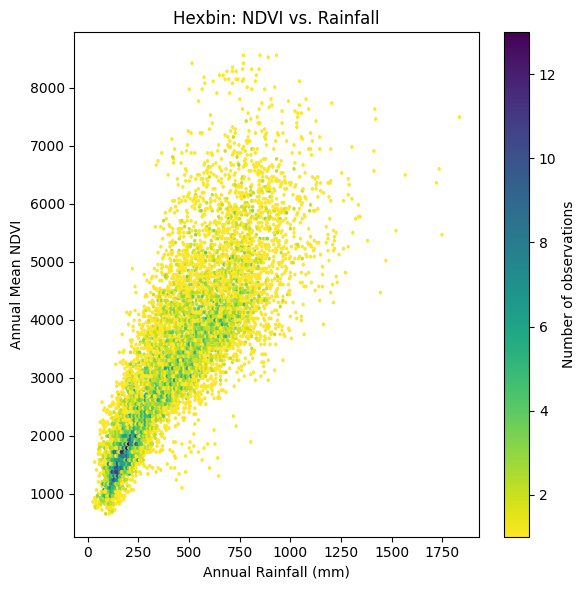

In [103]:
# ──────────────────────────────────────────────────────────────────────────────
# Quick hexbin plot of NDVI vs. Rainfall for all grid‐year points
# • Uses hexagonal binning to efficiently visualize large point clouds
# • ‘gridsize’ controls the number of bins per axis (higher ⇒ finer detail)
# • ‘mincnt=1’ filters out empty bins for clarity
# ------------------------------------------------------------------------------
plt.figure(figsize=(6, 6))

# Create the hexbin; returns a QuadMesh for which we can draw a colorbar
hb = plt.hexbin(
    df_long["rain"],    # x: annual rainfall (mm)
    df_long["ndvi"],    # y: annual mean NDVI
    gridsize=200,       # number of hexagons along x-axis
    cmap="viridis_r",   # inverted viridis colormap
    mincnt=1            # only draw bins with count ≥ 1
)

# Add colorbar showing count per hexagon
cb = plt.colorbar(hb)
cb.set_label("Number of observations")

# Axis labels and title
plt.xlabel("Annual Rainfall (mm)")
plt.ylabel("Annual Mean NDVI")
plt.title("Hexbin: NDVI vs. Rainfall")

plt.tight_layout()
plt.show()


In [106]:
# ──────────────────────────────────────────────────────────────────────────────
# 1. Sort & prepare the DataFrame
#    • Ensure data are ordered by grid cell and year before lagging
# ------------------------------------------------------------------------------
df_long = df_long.sort_values(['grid_id', 'year']).reset_index(drop=True)

# 2. Create a one‐year lag of rainfall per grid cell
#    • For each grid_id, shift the 'rain' series by one year
#    • First year per cell will have NaN lag → excluded later
df_long['rain_lag1'] = df_long.groupby('grid_id')['rain'].shift(1)
print(df_long[['grid_id', 'year', 'rain', 'rain_lag1']].head())

# ──────────────────────────────────────────────────────────────────────────────
# 3. Build predictor (exog) and response (endog) arrays for regression
#    • X includes current‐year rain and one‐year lag
#    • Mask out rows where lag is NaN (first record per grid)
# ------------------------------------------------------------------------------
X = df_long[['rain', 'rain_lag1']].values
y = df_long['ndvi'].values

mask = ~np.isnan(X).any(axis=1)
X_valid = X[mask]
y_valid = y[mask]

# ──────────────────────────────────────────────────────────────────────────────
# 4. Fit an Ordinary Least Squares (OLS) model with statsmodels
#    • Add a constant term for the intercept
#    • Use named columns to preserve parameter labels
# ------------------------------------------------------------------------------
exog_df = pd.DataFrame(X_valid, columns=['rain', 'rain_lag1'])
exog_df = sm.add_constant(exog_df)  # adds 'const' column

ols = sm.OLS(y_valid, exog_df).fit()

# ──────────────────────────────────────────────────────────────────────────────
# 5. Extract results: coefficients, p‐values, R², RMSE
# ------------------------------------------------------------------------------
params = ols.params
pvals  = ols.pvalues

# Helper for significance stars
def stars(p):
    if p < 0.001: return '***'
    if p < 0.01:  return '**'
    if p < 0.05:  return '*'
    return ''

print("Regression results (with p-values):")

# Intercept
ci, pi = params['const'], pvals['const']
print(f"  • {'intercept':12s} = {ci:8.4f}   p = {pi:.3f} {stars(pi)}")

# Slopes for rain and rain_lag1
for name in ['rain', 'rain_lag1']:
    slope, p = params[name], pvals[name]
    print(f"  • {name:12s} slope = {slope:8.4f}   p = {p:.3f} {stars(p)}")

# Model performance metrics
r2   = ols.rsquared
rmse = np.sqrt(mean_squared_error(y_valid, ols.fittedvalues))
print(f"  • R²   = {r2:.4f}")
print(f"  • RMSE = {rmse:.4f}")

  grid_id  year       rain  rain_lag1
0  g_0_12  2000  56.837139        NaN
1  g_0_12  2001  68.682198  56.837139
2  g_0_12  2002  80.049091  68.682198
3  g_0_12  2003  59.556581  80.049091
4  g_0_12  2004  63.098338  59.556581
Regression results (with p-values):
  • intercept    = 1079.6774   p = 0.000 ***
  • rain         slope =   3.2338   p = 0.000 ***
  • rain_lag1    slope =   1.8783   p = 0.000 ***
  • R²   = 0.7049
  • RMSE = 794.5770


In [107]:
# ──────────────────────────────────────────────────────────────────────────────
# 0. AGGREGATE TO TOTAL MEANS per grid cell
#    • For each grid_id & year, compute mean NDVI, mean rain, and mean lag‐rain
# ------------------------------------------------------------------------------
stats_df = (
    df_long
      .groupby('grid_id', as_index=False)
      .agg(
          ndvi_mean     = ('ndvi',      'mean'),
          rain_mean     = ('rain',      'mean'),
          rain_lag_mean = ('rain_lag1', 'mean')
      )
)
# print("Annual summary (first rows):")
# print(stats_df.head())

# ──────────────────────────────────────────────────────────────────────────────
# 1. DROP YEARS WHERE LAG IS MISSING (first record per grid)
# ------------------------------------------------------------------------------
stats_df_noNA = stats_df.dropna(subset=['rain_lag_mean']).reset_index(drop=True)
# print("After dropping missing lag (first rows):")
# print(stats_df_noNA.head())

# ──────────────────────────────────────────────────────────────────────────────
# 2. PREPARE DATA FOR OLS REGRESSION
#    • Predict NDVI from current‐year rain and one‐year lag
# ------------------------------------------------------------------------------
X = stats_df_noNA[['rain_mean', 'rain_lag_mean']]
y = stats_df_noNA['ndvi_mean']

# Add intercept term
X = sm.add_constant(X)  # adds 'const' column

# ──────────────────────────────────────────────────────────────────────────────
# 3. FIT THE OLS MODEL
# ------------------------------------------------------------------------------
ols = sm.OLS(y, X).fit()

# ──────────────────────────────────────────────────────────────────────────────
# 4. EXTRACT RESULTS: parameters, p‐values, R², RMSE
# ------------------------------------------------------------------------------
params = ols.params
pvals  = ols.pvalues
fitted = ols.fittedvalues

# Helper to format significance stars
def stars(p):
    return '***' if p < 0.001 else '**' if p < 0.01 else '*' if p < 0.05 else ''

print("\nRegression results (with p-values):")
# Intercept
ci, pi = params['const'], pvals['const']
print(f"  • {'intercept':12s} = {ci:8.4f}   p = {pi:.3f} {stars(pi)}")

# Slopes
for name in ['rain_mean', 'rain_lag_mean']:
    slope, p = params[name], pvals[name]
    print(f"  • {name:12s} slope = {slope:8.4f}   p = {p:.3f} {stars(p)}")

# Performance metrics
r2   = ols.rsquared
rmse = np.sqrt(mean_squared_error(y, fitted))
print(f"  • R²   = {r2:.4f}")
print(f"  • RMSE = {rmse:.4f}")


   grid_id    ndvi_mean   rain_mean  rain_lag_mean
0   g_0_12  1791.597763   62.232571      62.306261
1   g_10_1  5092.771645  445.673009     440.734930
2  g_10_10  1632.240260  174.701025     175.417663
3  g_10_11  1822.667749  187.760828     188.236350
4  g_10_12  1653.313853  190.277223     188.821732

Regression results (with p-values):
  • intercept    = 980.1306   p = 0.000 ***
  • rain_mean    slope =   8.6816   p = 0.270 
  • rain_lag_mean slope =  -3.3884   p = 0.667 
  • R²   = 0.7440
  • RMSE = 726.7209


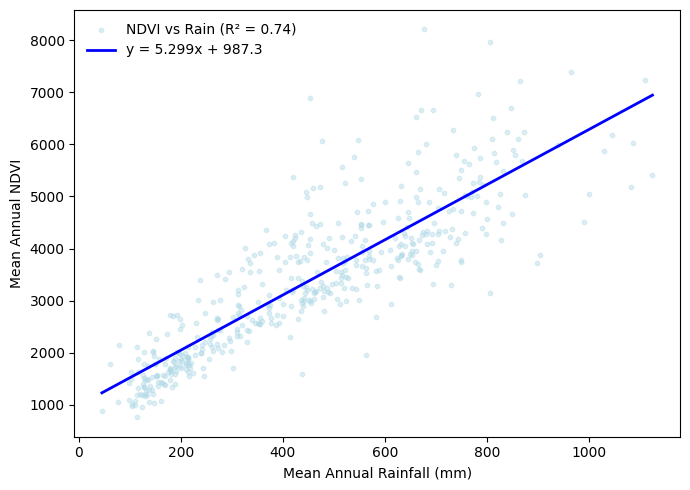

In [108]:
# ──────────────────────────────────────────────────────────────────────────────
# Scatter plot of annual mean NDVI vs. rainfall with linear trend line
# ------------------------------------------------------------------------------
plt.figure(figsize=(7, 5))

# 1. Scatter the data points
plt.scatter(
    stats_df_noNA['rain_mean'],      # x-axis: mean annual rainfall
    stats_df_noNA['ndvi_mean'],      # y-axis: mean annual NDVI
    color='lightblue',
    s=10,                             # marker size
    alpha=0.4,                        # transparency
    label=f'NDVI vs Rain (R² = {r2:.2f})'
)

# 2. Fit a simple linear model y = m*x + b
#    • Use numpy.polyfit to get slope (m) and intercept (b)
x_vals = stats_df_noNA['rain_mean'].values
y_vals = stats_df_noNA['ndvi_mean'].values
m, b = np.polyfit(x_vals, y_vals, 1) # type: ignore

# 3. Generate line endpoints over the x-range
xs = np.array([x_vals.min(), x_vals.max()]) # type: ignore
ys = m * xs + b

# 4. Plot the fitted line
plt.plot(
    xs, ys,
    color='blue',
    linewidth=2,
    label=f'y = {m:.3f}x + {b:.1f}'
)

# 5. Label axes and add legend
plt.xlabel('Mean Annual Rainfall (mm)')
plt.ylabel('Mean Annual NDVI')
plt.legend(frameon=False)

plt.tight_layout()
plt.show()

##### 8.2.	Effect of Distance-to-Roads on Sampling Effort
In this analysis we evaluate how accessibility—measured as distance from each grid‐cell centroid to the nearest major roads—influences sampling effort (total number of observations) across protected areas. We proceed in six main steps:

1. **Prepare the predictor raster**: We computed three Euclidean‐distance layers (dist_type1, dist_type2, dist_type3) corresponding to highways, primary, and secondary roads, then stacked them into a single multi‐band image (dist_stack).
2. **Assemble the response data**: From our earlier species‐grid summary, we built a GeoDataFrame (gdf_pts) of cell centroids with their total observation counts (sum_cnt) and square‐root transformation (sqrt_sum_cnt) to stabilize variance.
3. **Sample distances at each centroid**: Using sampleRegions(), we extracted the three distance bands at each centroid and converted the result to a pandas DataFrame (dist_df).
4. **Derive a single predictor**: We calculated the mean distance across road types (dist_mean) while retaining the individual distances for Types 1–3.
5. **Aggregate multi‐year effort into one raster**: We summed our multi‐band sampling‐effort GeoTIFF across time to produce a single “total effort” raster, which validates our per‐cell counts.
6. **Fit a linear regression**: Finally, we modeled the square‐root of total observations (√obs_sum) as a function of mean distance and the three individual road‐type distances:
`obs_sum ∼ 𝛽0 + 𝛽1 dist_mean + 𝛽2 dist_type1 + 𝛽3 dist_type2 + 𝛽4 dist_type3`   
We report each coefficient, its p-value (with significance stars), the model 𝑅2, and the RMSE to assess fit.

By framing distance‐to‐roads as our key accessibility predictor and using a square‐root transform on counts (rather than a full GAM), we provide a transparent baseline for understanding the strength and direction of sampling‐effort gradients relative to transport infrastructure.


In [155]:
# ──────────────────────────────────────────────────────────────────────────────
# 1. Turn a dataframe into a GeoDataFrame
# ------------------------------------------------------------------------------
obs_pts = gpd.GeoDataFrame(
    df_url,
    geometry=gpd.points_from_xy(df_url.decimalLongitude, df_url.decimalLatitude),
    crs="EPSG:4326"   # WGS84
)
print(f"Number of features in obs_pts: {len(obs_pts):,}")

# ──────────────────────────────────────────────────────────────────────────────
# 2. Create a summarised GeoDataFrame
# ------------------------------------------------------------------------------
# 2a. Round the lat/lon to 3 decimals
obs_pts = obs_pts.assign(
    lat_round = obs_pts.decimalLatitude.round(1),
    lon_round = obs_pts.decimalLongitude.round(1)
)

# 2b. aggregate
summary = (
    obs_pts
    .groupby(['lat_round','lon_round'])
    .agg(
        fam_rich = ('family',  'nunique'),
        spp_rich = ('species', 'nunique'),
        obs_sum   = ('species', 'count')
    )
    .reset_index()
)

# 2c. make it spatial again
summary_gdf = gpd.GeoDataFrame(
    summary,
    geometry=gpd.points_from_xy(summary.lon_round, summary.lat_round),
    crs=obs_pts.crs
)

# 2d. inspect
print(summary_gdf.head())
print(f"Number of features in obs_pts: {len(summary_gdf):,}")

# ──────────────────────────────────────────────────────────────────────────────
# 3. Prepare point FeatureCollection of grid centroids with effort & richness
# ------------------------------------------------------------------------------
obs_fc = geemap.geopandas_to_ee(
    summary_gdf[['lat_round','lon_round',
             'fam_rich','spp_rich','obs_sum','geometry']],
    geodesic=False
)
print(f"Number of points/features in obs_fc: {obs_fc.size().getInfo()}")


Number of features in obs_pts: 81,825
   lat_round  lon_round  fam_rich  spp_rich  obs_sum            geometry
0      -34.8       19.7         2         2        3  POINT (19.7 -34.8)
1      -34.8       19.8         1         1        1  POINT (19.8 -34.8)
2      -34.8       19.9         3         3        3  POINT (19.9 -34.8)
3      -34.8       20.0        10        21       49    POINT (20 -34.8)
4      -34.8       20.1         3         3        5  POINT (20.1 -34.8)
Number of features in obs_pts: 2,643
Number of points/features in obs_fc: 2643


In [157]:
# ──────────────────────────────────────────────────────────────────────────────
# 1. Sample distance‐to‐roads bands at each centroid
#    • yields dist_type1, dist_type2, dist_type3 per grid_id
# ------------------------------------------------------------------------------
sample_dist = dist_stack.sampleRegions(
    collection = gdf_pts, # Or use rounded observations obs_fc
    scale      = 5000,
    tileScale  = 4,
    geometries = False
)
print(f"Number of features in sample_dist: {sample_dist.size().getInfo()}")

# ──────────────────────────────────────────────────────────────────────────────
# 2. Convert to pandas DataFrame and compute mean distance
# ------------------------------------------------------------------------------
dist_df = geemap.ee_to_df(sample_dist)
# Compute average distance across types 1–3
dist_df['dist_mean'] = dist_df[['dist_type1','dist_type2','dist_type3']].mean(axis=1) # type: ignore
# print(dist_df.head())

# ──────────────────────────────────────────────────────────────────────────────
# 3. Fit OLS regression: √(sqrt_obs_sum) ~ dist_mean + dist_type1 + dist_type2 + dist_type3
# ------------------------------------------------------------------------------
# Prepare X and y from dist_df
X = dist_df[['dist_mean','dist_type1','dist_type2','dist_type3']]
y = dist_df['obs_sum']  # sqrt of total obs per cell

# Add intercept and fit model
X = sm.add_constant(X)
ols = sm.OLS(y, X).fit()

# Extract results
params = ols.params
pvals  = ols.pvalues
r2     = ols.rsquared
rmse   = np.sqrt(mean_squared_error(y, ols.fittedvalues))

# Significance stars helper
def stars(p):
    return '***' if p<0.001 else '**' if p<0.01 else '*' if p<0.05 else ''

# Report
print("\nRegression results (with p-values):")
print(f"  • {'intercept':12s} = {params['const']:8.4f}   p = {pvals['const']:.3f} {stars(pvals['const'])}")
for name in ['dist_mean','dist_type1','dist_type2','dist_type3']:
    print(f"  • {name:12s} slope = {params[name]:8.4f}   p = {pvals[name]:.3f} {stars(pvals[name])}")
print(f"  • R²   = {r2:.4f}")
print(f"  • RMSE = {rmse:.4f}")

Number of features in sample_dist: 401

Regression results (with p-values):
  • intercept    = 343.3379   p = 0.000 ***
  • dist_mean    slope =  -2.5410   p = 0.011 *
  • dist_type1   slope =  -2.1047   p = 0.015 *
  • dist_type2   slope =  -1.9765   p = 0.315 
  • dist_type3   slope =  -3.5420   p = 0.366 
  • R²   = 0.0484
  • RMSE = 551.9630


- **Intercept (343.34, p < 0.001)**: This is your “baseline” value when all your distance variables are zero. You’d predict about 343 units of your response (whatever you’re measuring) if mean distance were zero and you were in the reference distance‐type category. Because p < 0.001, you can be very confident the true intercept isn’t zero.

- **Mean distance slope (–2.54, p = 0.011)**: Every time the average distance increases by one unit, the predicted response drops by about 2.5 units. The p-value of 0.011 (< 0.05) tells you this negative relationship is statistically significant.

- **Distance type effects**: You’ve got three categorical “type” dummy variables (type1, type2, type3) comparing against a baseline type:
  - **Type1 (–2.10, p = 0.015)**: Being in type1 instead of the baseline reduces the response by ~2.1 units (significant at p < 0.05).

  - **Type2 (–1.98, p = 0.315)**: A similar drop (~2 units), but p = 0.315 means it could easily be just noise.

  - **Type3 (–3.54, p = 0.366)**: A larger drop (~3.5 units), but again p = 0.366 says this isn’t distinguishable from zero given your data.

- **R² = 0.0484**: Only 4.8 % of the variation in your response is explained by these distance predictors. In everyday terms, that’s a very weak model—most of what’s driving your response lies elsewhere.

- **RMSE ≈ 552**: On average, your model’s predictions miss the true value by about 552 units. If your response values are on the order of a few hundred, that’s a lot of error, confirming the model’s predictive power is low.

In other words, there is a small but statistically significant negative effect of mean distance (and of “type1” distance) on your response. The other distance types show negative slopes too, but you don’t have enough evidence to call them “real.” Overall, the distances you’ve included explain very little of what’s happening (low R² and high RMSE), so you’ll need to look for additional predictors or rethink the model form.

##### 8.3.	Key drivers of species diversity
Gradient-Boosted Decision Trees (XGBoost) handles complex, non-additive effects of multiple environmental covariates on species richness; built-in feature importance and SHAP values support transparent driver ranking. Predictor stacks are sampled from GEE and modelled in Python (`xgboost`, `scikit-learn`).


In [159]:
# ──────────────────────────────────────────────────────────────────────────────
# SAMPLE Bioclimatic Variables at Grid Centroids
#    • bioclim: EE Image with WORLDCLIM/V1 BIO01–BIO19 bands
#    • gdf_pts : EE FeatureCollection of grid-cell centroids with metadata
#    • Produces a wide table keyed by grid_id, with bio01–bio19 values
# ------------------------------------------------------------------------------
pts_bioclim = bioclim.sampleRegions(
    collection   = gdf_pts,   # grid centroids
    scale        = 5000,     # sampling resolution in metres
    tileScale    = 4,        # controls per‐tile complexity
    geometries   = False     # omit geometry field in output
)

# Inspect the EE object name
print('Type pts_bioclim:', pts_bioclim.name())

# Convert the sampled FeatureCollection to a pandas DataFrame
bioclim_df = geemap.ee_to_df(pts_bioclim)

# Preview the first few rows
print(bioclim_df.head())

Type pts_bioclim: FeatureCollection
      bio01     bio02    bio03      bio04     bio05    bio06     bio07  \
0  157.5000  101.8125  64.5000  1891.5000  230.2500  73.8125  156.4375   
1  179.6250  113.3125  62.1875  2350.9375  263.8125  82.9375  180.8750   
2  169.5000  116.0000  62.5000  2331.5000  263.0000  78.5000  184.5000   
3  162.6250  112.9375  61.7500  2400.1250  252.8125  71.3750  181.4375   
4  164.4375  114.1875  60.3125  2554.1875  254.5000  66.8125  187.6875   

     bio08     bio09     bio10  ...    bio15    bio16   bio17    bio18  \
0  133.875  175.0000  180.5625  ...  43.3125  26.2500  7.0625   9.0625   
1  167.625  201.5000  208.0000  ...  37.9375  16.3125  5.3750   8.3750   
2  142.000  197.0000  198.5000  ...  69.0000  62.0000  6.0000   8.0000   
3  135.750  184.5625  191.6875  ...  63.5000  54.2500  8.0000  10.0000   
4  136.750  188.5625  195.1250  ...  55.0000  35.0000  7.0000   8.0000   

     bio19  grid_id    lat    lon  obs_sum spp_rich  
0  25.8750   g_0_12 

In [161]:
# ──────────────────────────────────────────────────────────────────────────────
# 1. PREPARE FEATURES & TARGET
#    • Predictors: bio01–bio19
#    • Response : spp_rich or sqrt_sum_rich (√ species richness per cell)
# ------------------------------------------------------------------------------
bio_cols = [f"bio{str(i).zfill(2)}" for i in range(1, 20)]
X = bioclim_df[bio_cols]
y = bioclim_df["spp_rich"]

# ──────────────────────────────────────────────────────────────────────────────
# 2. TRAIN/TEST SPLIT
#    • 80% training, 20% testing
#    • random_state for reproducibility
# ------------------------------------------------------------------------------
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42
)

# ──────────────────────────────────────────────────────────────────────────────
# 3. FIT XGBOOST REGRESSOR
#    • 500 trees, max depth 4
#    • learning_rate controls shrinkage
#    • subsample & colsample_bytree for regularization
# ------------------------------------------------------------------------------
model = xgb.XGBRegressor(
    n_estimators=500,
    max_depth=4,
    learning_rate=0.05,
    subsample=0.8,
    colsample_bytree=0.8,
    random_state=42,
    verbosity=0
)
model.fit(
    X_train, y_train,
    eval_set=[(X_test, y_test)],
    verbose=False
)

# ──────────────────────────────────────────────────────────────────────────────
# 4. EVALUATE PERFORMANCE
#    • Predict on hold‐out set
#    • Compute R² and RMSE
# ------------------------------------------------------------------------------
y_pred = model.predict(X_test)
r2      = r2_score(y_test, y_pred)
rmse    = np.sqrt(mean_squared_error(y_test, y_pred))
print(f"XGBoost performance: R² = {r2:.3f}, RMSE = {rmse:.3f}")

XGBoost performance: R² = 0.324, RMSE = 65.955


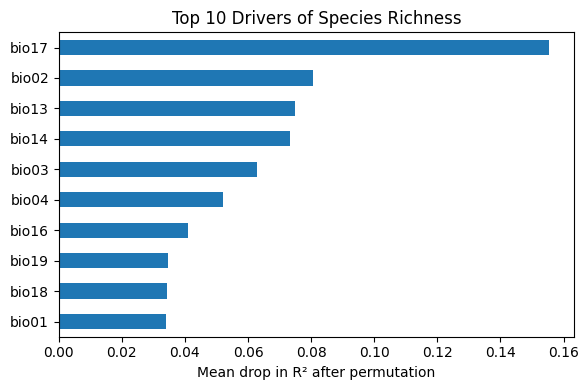

In [162]:
# ──────────────────────────────────────────────────────────────────────────────
# 1. Compute permutation importances on the test set
#    • Measures the decrease in R² when each feature is randomly shuffled
#    • n_repeats controls stability of estimates
# ------------------------------------------------------------------------------
results = permutation_importance(
    estimator    = model,      # trained XGBoost model
    X            = X_test,     # features of the test set
    y            = y_test,     # observed responses
    n_repeats    = 10,
    random_state = 42,
    n_jobs       = -1
)

# ──────────────────────────────────────────────────────────────────────────────
# 2. Convert to a pandas Series and sort descending
#    • results.importances_mean is the average R² drop per feature
# ------------------------------------------------------------------------------
perm_imp = pd.Series(
    results.importances_mean,  # type: ignore
    index = bio_cols
).sort_values(ascending=False)

# ──────────────────────────────────────────────────────────────────────────────
# 3. Display the top 10 predictor variables
# ------------------------------------------------------------------------------
# print("Top 10 drivers by permutation importance:\n", perm_imp.head(10))

# ──────────────────────────────────────────────────────────────────────────────
# 4. Visualize with a horizontal bar plot
# ------------------------------------------------------------------------------
plt.figure(figsize=(6, 4))
perm_imp.head(10).plot.barh()
plt.gca().invert_yaxis()  # highest importance on top
plt.xlabel("Mean drop in R² after permutation")
plt.title("Top 10 Drivers of Species Richness")
plt.tight_layout()
plt.show()



---
#### 9.	INTERPRET RESULTS AND MAP PREDICTIONS
> The final step translates model outputs into ecological insight and actionable spatial products. Begin by examining goodness-of-fit diagnostics—cross-validated RMSE, deviance, or posterior predictive checks—to judge model credibility. Next, interrogate driver importance and response curves: feature importance scores, SHAP values, or partial-dependence plots reveal how each environmental covariate shapes biodiversity patterns.
> Predicted surfaces and their uncertainties are then exported back to Google Earth Engine and rendered with geemap or folium. Interactive layers allow users to toggle between baseline predictions, scenario maps, and confidence intervals, facilitating rapid exploration of hotspots, refugia, or data-poor areas. Complex temporal outputs (e.g. yearly richness trends) can be animated to show change through time, while static high-resolution maps are generated for reports and policy briefs.
> Finally, link these visualisations to conservation objectives—such as identifying priority sampling gaps, forecasting climate-driven shifts, or evaluating management interventions—ensuring that data-cube analyses inform real-world biodiversity decisions.


In [163]:
# ──────────────────────────────────────────────────────────────────────────────
# 0. AGGREGATE TO ANNUAL MEANS per grid cell
#    • For each grid_id & year, compute mean NDVI, mean rain, and mean lag‐rain
# ------------------------------------------------------------------------------
stats_df = (
    df_long
      .groupby(['grid_id', 'year'], as_index=False)
      .agg(
          ndvi_mean     = ('ndvi',      'mean'),
          rain_mean     = ('rain',      'mean'),
          rain_lag_mean = ('rain_lag1', 'mean')
      )
)
# print("Annual summary (first rows):")
# print(stats_df.head())

# ──────────────────────────────────────────────────────────────────────────────
# 1. DROP YEARS WHERE LAG IS MISSING (first record per grid)
# ------------------------------------------------------------------------------
stats_df_noNA = stats_df.dropna(subset=['rain_lag_mean']).reset_index(drop=True)
# print("After dropping missing lag (first rows):")
# print(stats_df_noNA.head())

# ──────────────────────────────────────────────────────────────────────────────
# 2. PREPARE DATA FOR OLS REGRESSION
#    • Predict NDVI from current‐year rain and one‐year lag
# ------------------------------------------------------------------------------
X = stats_df_noNA[['rain_mean', 'rain_lag_mean']]
y = stats_df_noNA['ndvi_mean']

# Add intercept term
X = sm.add_constant(X)  # adds 'const' column

# ──────────────────────────────────────────────────────────────────────────────
# 3. FIT THE OLS MODEL
# ------------------------------------------------------------------------------
ols = sm.OLS(y, X).fit()

# ──────────────────────────────────────────────────────────────────────────────
# 4. EXTRACT RESULTS: parameters, p‐values, R², RMSE
# ------------------------------------------------------------------------------
params = ols.params
pvals  = ols.pvalues
fitted = ols.fittedvalues

# Helper to format significance stars
def stars(p):
    return '***' if p < 0.001 else '**' if p < 0.01 else '*' if p < 0.05 else ''

print("\nRegression results (with p-values):")
# Intercept
ci, pi = params['const'], pvals['const']
print(f"  • {'intercept':12s} = {ci:8.4f}   p = {pi:.3f} {stars(pi)}")

# Slopes
for name in ['rain_mean', 'rain_lag_mean']:
    slope, p = params[name], pvals[name]
    print(f"  • {name:12s} slope = {slope:8.4f}   p = {p:.3f} {stars(p)}")

# Performance metrics
r2   = ols.rsquared
rmse = np.sqrt(mean_squared_error(y, fitted))
print(f"  • R²   = {r2:.4f}")
print(f"  • RMSE = {rmse:.4f}")


Regression results (with p-values):
  • intercept    = 1079.6774   p = 0.000 ***
  • rain_mean    slope =   3.2338   p = 0.000 ***
  • rain_lag_mean slope =   1.8783   p = 0.000 ***
  • R²   = 0.7049
  • RMSE = 794.5770


-  **Intercept ≈ 1080**: This is the model’s “baseline” NDVI value when both current-year and last-year rainfall are zero. In reality we never see zero rainfall everywhere, but it anchors the line.
-  **Current-year rain slope ≈ 3.2 (p < 0.001)**: For every additional millimeter of rain this year, the model predicts NDVI will increase by about 3.2 units, all else being equal.
-  **Last-year (lagged) rain slope ≈ 1.9 (p < 0.001**): Conversely, every extra millimeter of rain last year is associated with an increase of about 1.9 NDVI units today. This suggests that wetter conditions in the previous year tend to leave behind healthier or more robust vegetation that shows up in the current NDVI measurements. This may seem counter-intuitive, but it often reflects timing or measurement issues—for example, very heavy rain can sometimes lower end-of-year greenness if clouds obscure satellite sensors, or if the “growing flush” happens later.
-  **R² ≈ 0.70**: The model explains about 70 % of the variation in NDVI across your grid cells and years. In ecological data that’s quite high, meaning these two rainfall terms capture most of the NDVI signal.
-  **RMSE ≈ 795**: On average, the model’s predictions are off by about 795 NDVI units. Given that MODIS NDVI ranges roughly 0–10 000, this is a moderate level of error—enough that you’d still see some scatter around the fitted surface, but not so large as to make the model unusable.

In other words, Vegetation greenness this year tends to be higher when rainfall this same year is especially high, and it’s higher when the previous year was wet byt to a lesser degree. Together, these two effects explain almost three-quarters of the variation in greenness we see across space and time, although individual predictions can still be off by a few hundred NDVI units.

In [168]:
# ──────────────────────────────────────────────────────────────────────────────
# 1. Fit the model, store slope/intercept in separate names
# ------------------------------------------------------------------------------
X = stats_df_noNA['rain_mean'].values.reshape(-1, 1)  # feature array # type: ignore
y = stats_df_noNA['ndvi_mean'].values                 # target array

X1 = sm.add_constant(X)      # adds intercept term
results = sm.OLS(y, X1).fit()

slope     = results.params[1]
intercept = results.params[0]
r2        = results.rsquared

print(f"Fitted model: NDVI = {slope:.4f}·rain + {intercept:.4f}   (R² = {r2:.3f})")

# ──────────────────────────────────────────────────────────────────────────────
# 2. Grab the 2008 rainfall band from your multi-band image
# ------------------------------------------------------------------------------
print("Rain monthly bands:", ndvi.first().bandNames().getInfo())
rain2008 = ndvi_rain_yearly_stack.select('rain_2008')

# ──────────────────────────────────────────────────────────────────────────────
# 3. Apply the linear model: multiply by slope, then add intercept
# ------------------------------------------------------------------------------
ndvi_pred_2008 = rain2008.multiply(slope).add(intercept).rename('ndvi_pred_2008')

# ──────────────────────────────────────────────────────────────────────────────
# 4. Now add your EE layer to the map
# ------------------------------------------------------------------------------
m.addLayer(ndvi_pred_2008,
           ndvi_vis, # reuse NDVI color scheme defined earlier
           'Predicted NDVI 2008') # reuse NDVI color scheme defined earlier

# 4. Display the map
m


Fitted model: NDVI = 4.9331·rain + 1161.5691   (R² = 0.683)


Map(center=[-24.5, 31.5], controls=(WidgetControl(options=['position', 'transparent_bg'], widget=SearchDataGUI…

---
#### 10.	SUPPLEMENTARY MATERIAL

##### PALETTES

In [ ]:
elev_vis = {'min': 0, 'max': 2000,
            'palette': ['#081d58', '#253494', '#225ea8',
                        '#1d91c0', '#41b6c4', '#7fcdbb',
                        '#c7e9b4', '#edf8b1', '#ffffd9']}

rain_vis = {'min': 0, 'max': 22,
            'palette': [
                '#ffffd9', '#edf8b1', '#c7e9b4',
                '#7fcdbb', '#41b6c4', '#1d91c0',
                '#225ea8', '#253494', '#081d58'
            ]}

##### BUILD A FINER GRID AND SUMMARIZE OBSERVATIONS

In [ ]:
# # ──────────────────────────────────────────────────────────────────────────────
# # 1. BUILD A FINER GRID AND SUMMARIZE OBSERVATIONS
# #    • res=0.25° (~28 km) grid in EPSG:4326
# # ------------------------------------------------------------------------------
# grid_counts, grid_polys = species_grid_summary(
#     df_url,
#     res=0.25,
#     unit="deg"
# )

# # ──────────────────────────────────────────────────────────────────────────────
# # 2. AGGREGATE PER-CELL TOTALS & RICHNESS
# #    • sum_cnt: total observations per cell
# #    • sum_rich: unique species per cell
# # ------------------------------------------------------------------------------
# cent_df = (
#     grid_counts
#       .groupby(['grid_id','centroid_lat','centroid_lon'], as_index=False)
#       .agg(
#           sum_cnt  = ('count',   'sum'),
#           sum_rich = ('species', 'nunique')
#       )
# )

# # Square‐root transform for normality
# cent_df['sqrt_sum_cnt']  = np.sqrt(cent_df['sum_cnt'])
# cent_df['sqrt_sum_rich'] = np.sqrt(cent_df['sum_rich'])

# # ──────────────────────────────────────────────────────────────────────────────
# # 3. CONVERT CELL CENTROIDS TO EE POINTS
# #    • Retain key metrics for sampling
# # ------------------------------------------------------------------------------
# crs_wgs84 = "EPSG:4326"
# gdf_pts = gpd.GeoDataFrame(
#     cent_df,
#     geometry=gpd.points_from_xy(cent_df['centroid_lon'], cent_df['centroid_lat']),
#     crs=crs_wgs84
# )

# pts_fc = geemap.geopandas_to_ee(
#     gdf_pts[['grid_id','centroid_lon','centroid_lat',
#              'sum_cnt','sqrt_sum_cnt','sum_rich','sqrt_sum_rich','geometry']],
#     geodesic=False
# )

# # ──────────────────────────────────────────────────────────────────────────────
# # 4. SAMPLE DISTANCE‐TO‐ROADS AT EACH CENTROID
# #    • dist_stack has bands 'dist_type1','dist_type2','dist_type3'
# # ------------------------------------------------------------------------------
# sample_dist = dist_stack.sampleRegions(
#     collection=pts_fc,
#     scale=5000,
#     tileScale=4,
#     geometries=False
# )
# dist_df = geemap.ee_to_pandas(sample_dist)

# # Compute mean distance across the three road types
# dist_df['dist_mean'] = dist_df[['dist_type1','dist_type2','dist_type3']].mean(axis=1) # type: ignore

# # ──────────────────────────────────────────────────────────────────────────────
# # 5. FIT OLS: √(obs_sum) ~ dist_mean + dist_type1 + dist_type2 + dist_type3
# # ------------------------------------------------------------------------------
# X = dist_df[['dist_mean','dist_type1','dist_type2','dist_type3']]
# y = dist_df['sqrt_sum_cnt']

# # Add intercept
# X = sm.add_constant(X)
# ols = sm.OLS(y, X).fit()

# # Extract results
# params = ols.params
# pvals  = ols.pvalues
# r2     = ols.rsquared
# rmse   = np.sqrt(mean_squared_error(y, ols.fittedvalues))

# # Helper for significance stars
# def stars(p):
#     return '***' if p<0.001 else '**' if p<0.01 else '*' if p<0.05 else ''

# # ──────────────────────────────────────────────────────────────────────────────
# # 6. REPORT REGRESSION OUTPUT
# # ------------------------------------------------------------------------------
# print("Regression results (√obs_sum ~ distances):\n")
# print(f"  • {'intercept':12s} = {params['const']:8.4f}   p = {pvals['const']:.3f} {stars(pvals['const'])}")
# for name in ['dist_mean','dist_type1','dist_type2','dist_type3']:
#     print(f"  • {name:12s} = {params[name]:8.4f}   p = {pvals[name]:.3f} {stars(pvals[name])}")
# print(f"\n  • R²   = {r2:.4f}")
# print(f"  • RMSE = {rmse:.4f}")